# Quantifying the Background Sky Over-/Under-subtraction

## February 2020 Analysis Sprint (Scrapbook)

### Overview

Aim to use sky objects generated on DEEP/WIDE data to explore the sky level as a function of local source flux.

We create a re-run of [DM-21386](https://jira.lsstcorp.org/browse/DM-21386) for tract 9813, patch 2,2 in the r-band on the command line:

`$ setup lsst_distrib`<br>
`$ measureCoaddSources.py /datasets/hsc/repo --rerun RC/w_2019_38/DM-21386:private/lskelvin/apertures_nfalse --id tract=9813 patch=2,2 filter=HSC-R --configfile config.py -c measurement.doReplaceWithNoise=False`

and with this `config.py` file:

`config.measurement.plugins['base_CircularApertureFlux'].radii=[3.0, 4.5, 6.0, 9.0, 12.0, 17.0, 25.0, 35.0, 50.0, 70.0, 250.0, 500.0]`

As can be seen, the config option 'doReplaceWithNoise' has been set to `False`, such that secondary sources within a given circular aperture will not have the pixels in their footprint set to random Poisson noise. Note also that we add two additional larger circular apertures (r=250 and r=500) than usual.

An extra rerun with `measurement.doReplaceWithNoise=True` is also run, to provide a baseline comparison.

N.B. - this notebook last successfully run using `w_2020_07`.

In [1]:
# imports
import os
import sys
import warnings
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import astropy.stats as stats
from collections import Counter as count
import pandas as pd
import pickle

# LSST stack imports
import lsst.daf.persistence as dafPersist
import lsst.afw.display as afwDisplay
from lsst.ip.isr import IsrTask
import lsst.afw.detection as afwDetection

In [2]:
def makemaskdict(desired, current):
    """Convenience function to set mask planes."""
    keys = current.keys()
    output = {key: 'IGNORE' for key in keys}
    for key in keys:
        if key in desired.keys():
            output[key] = desired[key]
    return output

In [3]:
def rebin(arr, shape):
    """Rebin 2D array."""
    if shape != arr.shape:
        new_shape = (int(shape[0]), arr.shape[0] // int(shape[0]),
                int(shape[1]), arr.shape[1] // int(shape[1]))
        return arr.reshape(new_shape).mean(-1).mean(1)
    else:
        return arr

In [4]:
def imprep(data, lo = None, hi = None, scaleLo = None, scaleHi = None, scale = 100, block = 1, fwhm = 0):
    """Prepare image for plotting."""
    if fwhm > 0:
        from scipy.ndimage import gaussian_filter as gauss
        sigma = fwhm / (2 * np.sqrt(2 * np.log(2)))
        data_new = gauss(input=data, sigma=sigma)
        data = data_new
    if lo is None:
        if scaleLo is None:
            scaleLo = (100 - scale) / 2
        lo = np.quantile(data, scaleLo / 100)
    if hi is None:
        if scaleHi is None:
            scaleHi = 100 - (100 - scale) / 2
        hi = np.quantile(data, scaleHi / 100)
    temp = (data - lo) / (hi - lo)
    temp = np.clip(temp, a_min = 0, a_max = 1)
    temp *= 500
    temp = np.log10(temp + 0.5)
    maplo = np.log10(0.5)
    maphi = np.log10(500 + 0.5)
    temp = (temp - maplo) / (maphi - maplo)
    new_shape = tuple(np.array(temp.shape) / block / block)
    temp = rebin(temp, shape=new_shape)
    return temp, lo, hi

In [5]:
def getradflux(butler, dataid, radius):
    """Extract relevant circular aperture flux measurements from the butler."""
    subtable = butler.get('deepCoadd_meas', dataId=dataid)
    subskyobjects = subtable[subtable['merge_peak_sky'] & ~subtable['base_PixelFlags_flag_edge']]
    flux = subskyobjects['base_CircularApertureFlux_{}_0_instFlux'.format(radius)]
    flag = ~subskyobjects['base_CircularApertureFlux_{}_0_flag'.format(radius)]
    area = np.pi * (radius**2)
    fluxperpixel = flux / area
    x = subskyobjects['base_SdssCentroid_x']
    y = subskyobjects['base_SdssCentroid_y']
    return flux, fluxperpixel, flag, x, y

In [6]:
# setup data ID and butlers
dataid = {'tract': 9813, 'patch': '2,2', 'filter': 'HSC-R'}
butler0 = dafPersist.Butler("/datasets/hsc/repo/rerun/RC/w_2019_38/DM-21386/")
butlernrf = dafPersist.Butler("/project/lskelvin/hsc-rerun/apertures_nfalse")
butlernrt = dafPersist.Butler("/project/lskelvin/hsc-rerun/apertures_ntrue")

In [7]:
# get initial data
coadd = butler0.get('deepCoadd', dataId=dataid)
calexp = butler0.get('deepCoadd_calexp', dataId=dataid)
wcs = coadd.getWcs()
table0 = butler0.get('deepCoadd_meas', dataId=dataid)
tablenrf = butlernrf.get('deepCoadd_meas', dataId=dataid)
tablenrt = butlernrt.get('deepCoadd_meas', dataId=dataid)
skyobjects0 = table0[table0['merge_peak_sky']]
skyobjectsnrf = tablenrf[tablenrf['merge_peak_sky']]
skyobjectsnrt = tablenrt[tablenrt['merge_peak_sky']]
magzp = calexp.getPhotoCalib().instFluxToMagnitude(1)

In [8]:
# load rerun data
r500flux, r500fluxperpixel, r500flag, xt, yt = getradflux(butlernrf, dataid, 500)
r250flux, r250fluxperpixel, r250flag, xt, yt = getradflux(butlernrf, dataid, 250)
r9flux, r9fluxperpixel, r9flag, xt, yt = getradflux(butlernrf, dataid, 9)
annflux = r500flux - r250flux
annarea = (np.pi * (500**2)) - (np.pi * (250**2))
annfluxperpixel = annflux / annarea

In [9]:
# get centroids
x0 = skyobjects0.getX()
y0 = skyobjects0.getY()
xnrf = skyobjectsnrf.getX()
ynrf = skyobjectsnrf.getY()
xnrt = skyobjectsnrt.getX()
ynrt = skyobjectsnrt.getY()
nrfoffset = np.sqrt(((xnrt-xnrf)**2) + ((ynrt-ynrf)**2))
butoffset = np.sqrt(((xnrt-x0)**2) + ((ynrt-y0)**2))

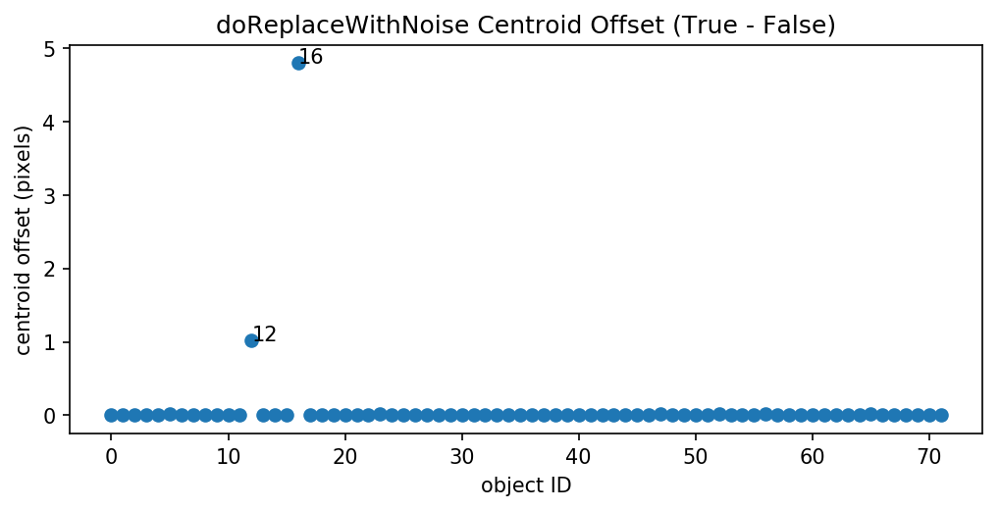

In [10]:
# noise replace false centroid offset
%matplotlib inline
fig = plt.figure(figsize=(8,3.5), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
plt.scatter(range(len(nrfoffset)), nrfoffset)
ax.set_xlabel('object ID')
ax.set_ylabel('centroid offset (pixels)')
ax.set_title('doReplaceWithNoise Centroid Offset (True - False)')
ax.text(12,nrfoffset[12],'12')
ax.text(16,nrfoffset[16],'16')
plt.show()

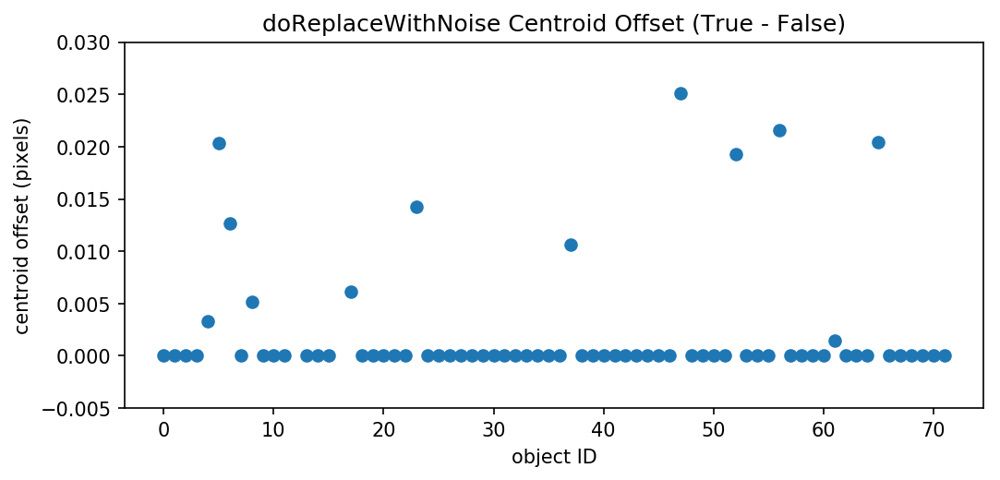

In [11]:
# noise replace false centroid offset
%matplotlib inline
fig = plt.figure(figsize=(8,3.5), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
plt.scatter(range(len(nrfoffset)), nrfoffset)
ax.set_xlabel('object ID')
ax.set_ylabel('centroid offset (pixels)')
ax.set_title('doReplaceWithNoise Centroid Offset (True - False)')
ax.set_ylim(-0.005,0.03)
plt.show()

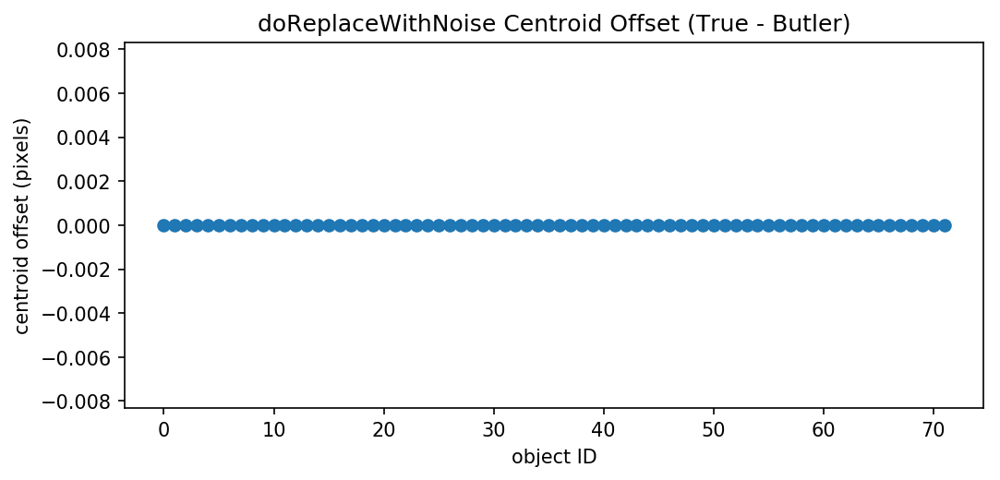

In [12]:
# noise replace true centroid offset
%matplotlib inline
fig = plt.figure(figsize=(8,3.5), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
plt.scatter(range(len(butoffset)), butoffset)
ax.set_xlabel('object ID')
ax.set_ylabel('centroid offset (pixels)')
ax.set_title('doReplaceWithNoise Centroid Offset (True - Butler)')
plt.show()

In [13]:
# # remove offset x/y positions
# bad = np.where((np.abs(x0-xnrf)>0.1) | (np.abs(y0-ynrf)>0.1) | (np.abs(x0-xnrt)>0.1) | (np.abs(y0-ynrt)>0.1))
# x0 = np.delete(x0, bad)
# y0 = np.delete(y0, bad)
# xnrf = np.delete(xnrf, bad)
# ynrf = np.delete(ynrf, bad)
# xnrt = np.delete(xnrt, bad)
# ynrt = np.delete(ynrt, bad)
# r500flux = np.delete(r500flux, bad)
# r500fluxperpixel = np.delete(r500fluxperpixel, bad)
# r500flag = np.delete(r500flag, bad)
# r250flux = np.delete(r250flux, bad)
# r250fluxperpixel = np.delete(r250fluxperpixel, bad)
# r250flag = np.delete(r250flag, bad)
# r9flux = np.delete(r9flux, bad)
# r9fluxperpixel = np.delete(r9fluxperpixel, bad)
# r9flag = np.delete(r9flag, bad)
# annflux = np.delete(annflux, bad)
# annfluxperpixel = np.delete(annfluxperpixel, bad)

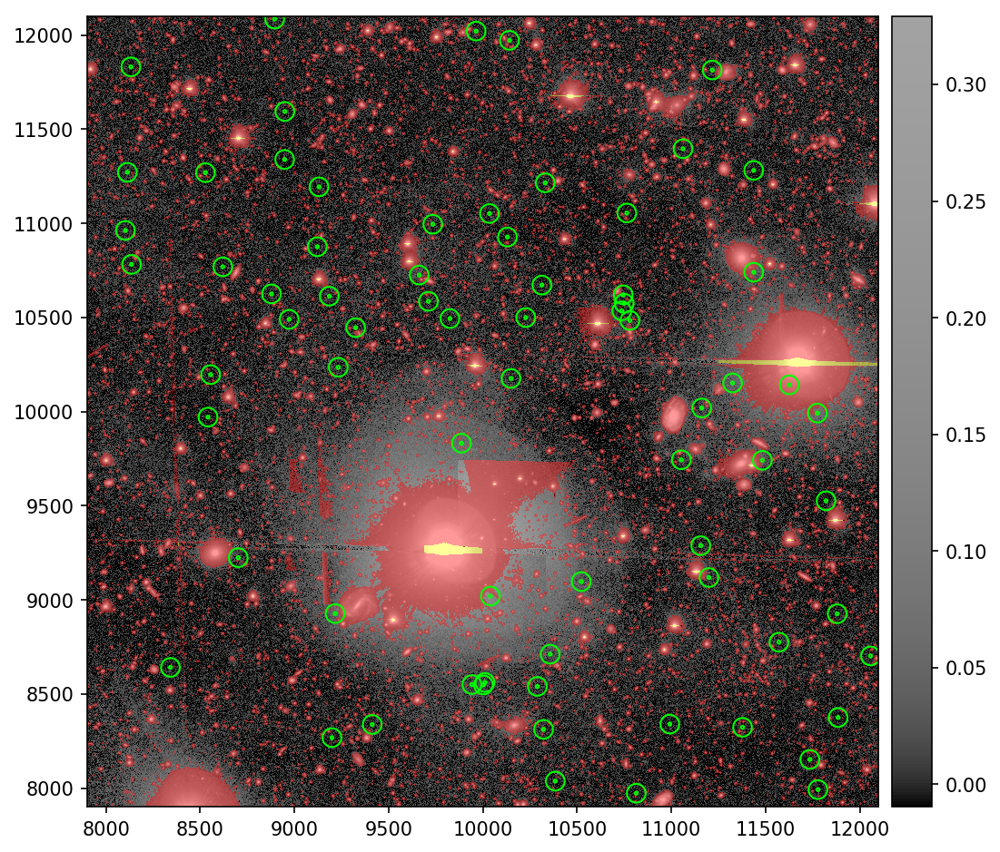

In [14]:
# precal image
%matplotlib inline
fig = plt.figure(figsize=(8, 8), dpi=150, facecolor='w', edgecolor='k')
display = afwDisplay.getDisplay(backend='matplotlib', frame=fig)
mpdict = {"DETECTED": "RED", 
          "DETECTED_NEGATIVE": "GREEN", 
          "BAD": "MAGENTA", 
          "NO_DATA": "YELLOW"}
mpdictfull = makemaskdict(mpdict, coadd.mask.getMaskPlaneDict())
display.setMaskPlaneColor(mpdictfull)
display.scale("asinh", np.quantile(coadd.image.array, 0.2), np.quantile(coadd.image.array, 0.8))
display.setMaskTransparency(60)
display.mtv(coadd)
for s in skyobjects0:
    display.dot("o", s.getX(), s.getY(), size=8, ctype='green')
    display.dot("o", s.getX(), s.getY(), size=50, ctype='green')
display.close()

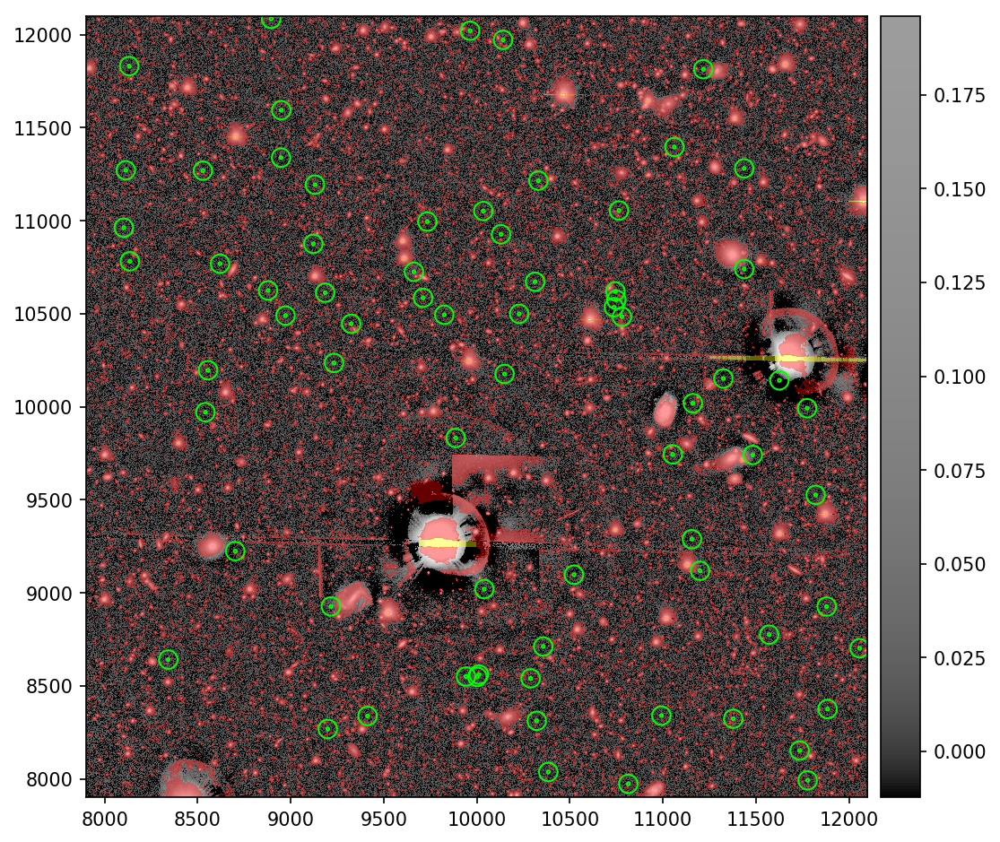

In [15]:
# calexp image
%matplotlib inline
fig = plt.figure(figsize=(8, 8), dpi=150, facecolor='w', edgecolor='k')
display = afwDisplay.getDisplay(backend='matplotlib', frame=fig)
mpdict = {"DETECTED": "RED", 
          "DETECTED_NEGATIVE": "GREEN", 
          "BAD": "MAGENTA", 
          "NO_DATA": "YELLOW"}
mpdictfull = makemaskdict(mpdict, calexp.mask.getMaskPlaneDict())
display.setMaskPlaneColor(mpdictfull)
display.scale("asinh", np.quantile(calexp.image.array, 0.2), np.quantile(calexp.image.array, 0.8))
display.setMaskTransparency(60)
display.mtv(calexp)
for s in skyobjects0:
    display.dot("o", s.getX(), s.getY(), size=8, ctype='green')
    display.dot("o", s.getX(), s.getY(), size=50, ctype='green')
display.close()

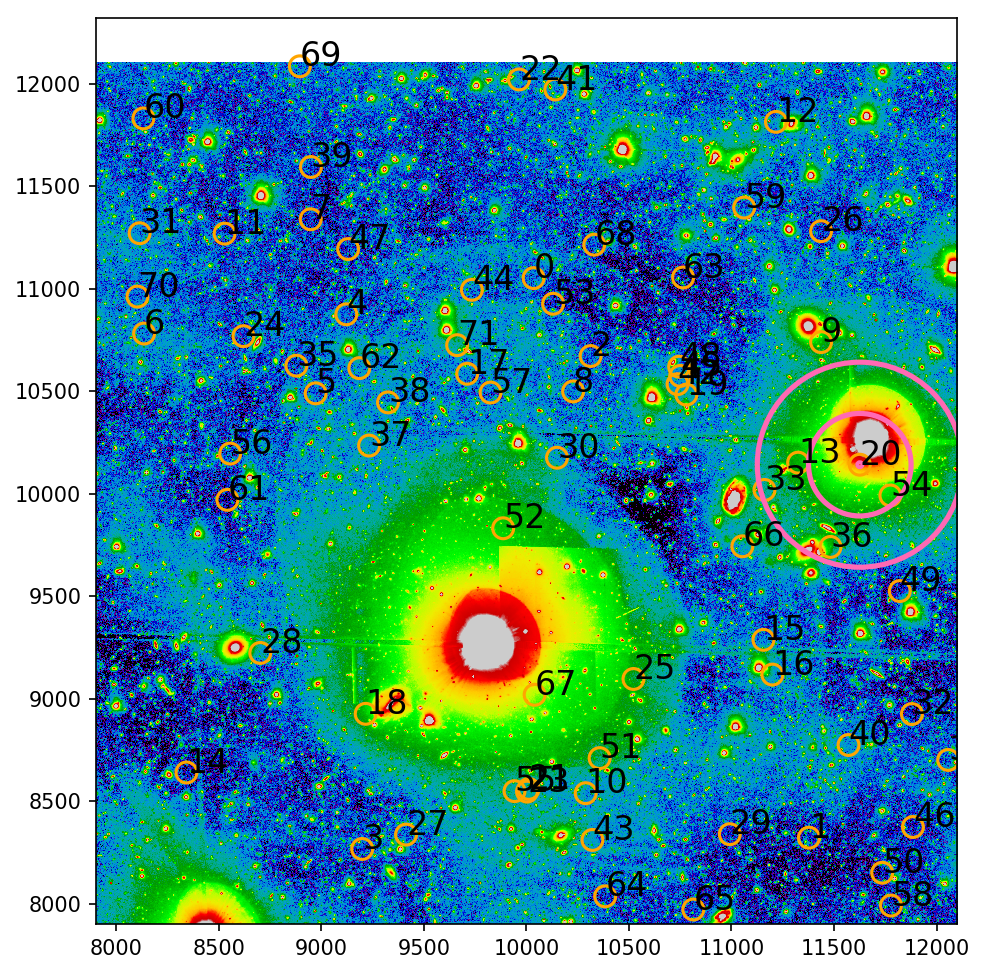

In [16]:
# precal annotated
%matplotlib inline
fig = plt.figure(figsize=(8,8), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
img, lo, hi = imprep(np.flip(coadd.image.array, 0), scale=99.99, fwhm=3, lo=-0.01, hi=2)
extent = (coadd.image.getBBox().getBeginX(), coadd.image.getBBox().getEndX(), 
          coadd.image.getBBox().getBeginY(), coadd.image.getBBox().getEndY())
plt.imshow(img, extent=extent, cmap="nipy_spectral")
plt.scatter(x=x0, y=y0, s=100, facecolors='none', edgecolors='orange', linewidth=1.5)
cid = 20
bigcircles = plt.Circle((x0[cid], y0[cid]), radius=500, fc='none', ec='hotpink', lw=2.5)
medcircles = plt.Circle((x0[cid], y0[cid]), radius=250, fc='none', ec='hotpink', lw=2.5)
smallcircles = plt.Circle((x0[cid], y0[cid]), radius=9, fc='none', ec='hotpink', lw=2.5)
plt.gcf().gca().add_artist(bigcircles)
plt.gcf().gca().add_artist(medcircles)
plt.gcf().gca().add_artist(smallcircles)
for i, txt in enumerate(range(len(x0))):
    ax.annotate(txt, (x0[i], y0[i]), color='black', fontsize=16, clip_on=True)
plt.show()

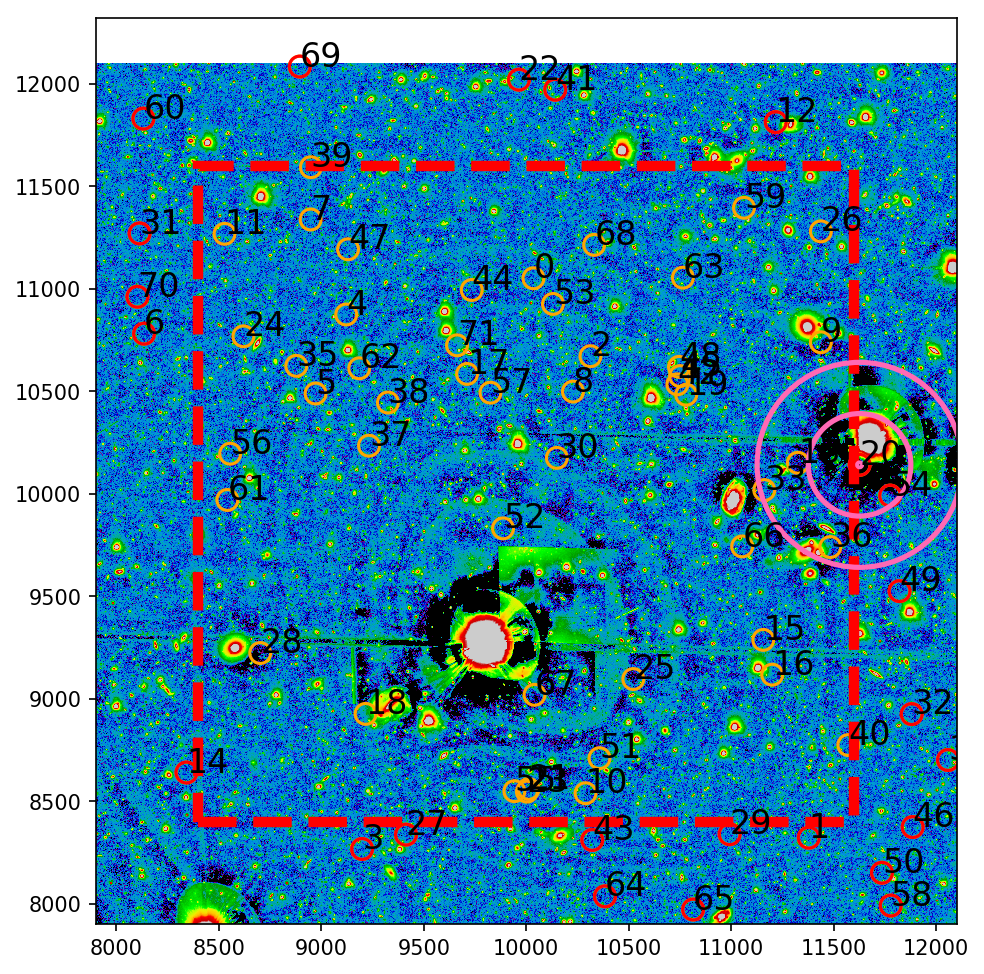

In [17]:
# calexp annotated
%matplotlib inline
fig = plt.figure(figsize=(8,8), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
img, lo, hi = imprep(np.flip(calexp.image.array, 0), scale=99.99, fwhm=3, lo=-0.01, hi=2)
extent = (calexp.image.getBBox().getBeginX(), calexp.image.getBBox().getEndX(), 
          calexp.image.getBBox().getBeginY(), calexp.image.getBBox().getEndY())
plt.imshow(img, extent=extent, cmap="nipy_spectral")
plt.scatter(x=x0, y=y0, s=100, facecolors='none', edgecolors='orange', linewidth=1.5)
isnan = np.isnan(r500fluxperpixel)
plt.scatter(x=x0[isnan], y=y0[isnan], s=100, facecolors='none', edgecolors='red', linewidth=1.5)
rect = matplotlib.patches.Rectangle((500+coadd.image.getBBox().getBeginX(),
                                     500+coadd.image.getBBox().getBeginY()), 
                                    3200, 3200, linewidth=5, edgecolor='r', facecolor='none', ls='--')
plt.gca().add_patch(rect)
cid = 20
bigcircles = plt.Circle((x0[cid], y0[cid]), radius=500, fc='none', ec='hotpink', lw=2.5)
medcircles = plt.Circle((x0[cid], y0[cid]), radius=250, fc='none', ec='hotpink', lw=2.5)
smallcircles = plt.Circle((x0[cid], y0[cid]), radius=9, fc='none', ec='hotpink', lw=2.5)
plt.gcf().gca().add_artist(bigcircles)
plt.gcf().gca().add_artist(medcircles)
plt.gcf().gca().add_artist(smallcircles)
for i, txt in enumerate(range(len(x0))):
    ax.annotate(txt, (x0[i], y0[i]), color='black', fontsize=16, clip_on=True)
plt.show()

In [18]:
# high flux region
cid = 20
print(r9fluxperpixel[cid])
print(r250fluxperpixel[cid])
print(r500fluxperpixel[cid])
print(annfluxperpixel[cid])

-0.056718201927155494
1.2515662404844599
nan
nan


In [19]:
# intermediate flux region
cid = 25
print(r9fluxperpixel[cid])
print(r250fluxperpixel[cid])
print(r500fluxperpixel[cid])
print(annfluxperpixel[cid])

-0.01033956659948804
0.031881271742578196
0.028507858708397216
0.027383387697003554


In [20]:
# low flux region
cid = 47
print(r9fluxperpixel[cid])
print(r250fluxperpixel[cid])
print(r500fluxperpixel[cid])
print(annfluxperpixel[cid])

0.0030640933653350785
0.009021271177353166
0.026124497955790308
0.03182557354860269


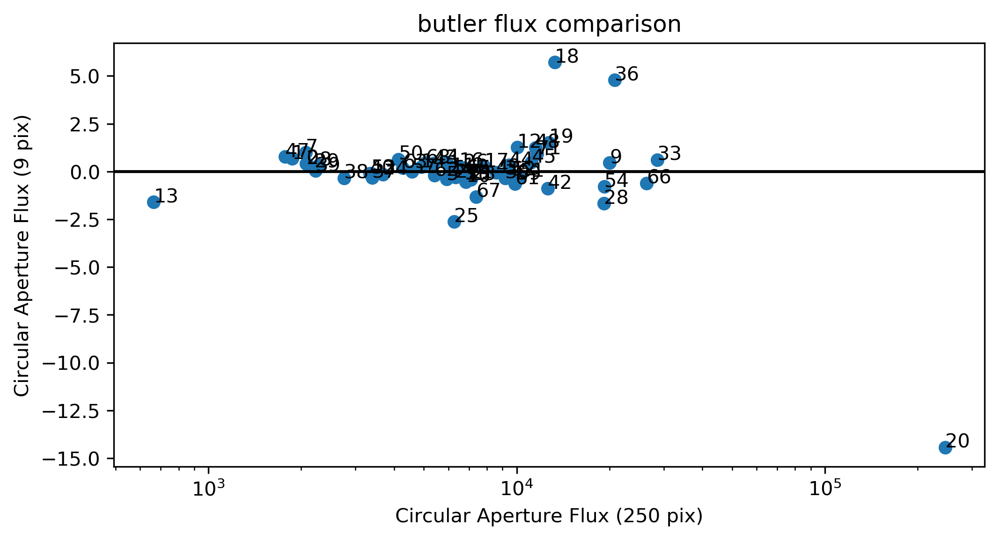

In [21]:
# 250 pixel vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(r250flux, r9flux)
for i, txt in enumerate(range(len(r9flux))):
    ax.annotate(txt, (r250flux[i], r9flux[i]), clip_on=True)
plt.axhline(y=0, c='k')
# ax.set_xlim(0.003,30000)
# ax.set_ylim((-5,5))
ax.set_xscale('log')
plt.xlabel('Circular Aperture Flux (250 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('butler flux comparison')
plt.show()

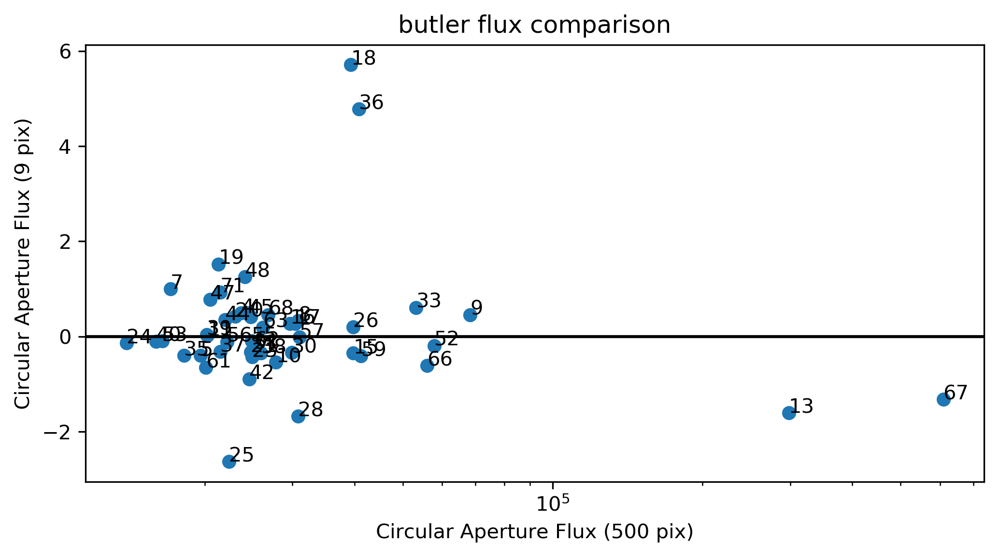

In [22]:
# 500 pixel vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(r500flux, r9flux)
for i, txt in enumerate(range(len(r9flux))):
    ax.annotate(txt, (r500flux[i], r9flux[i]), clip_on=True)
plt.axhline(y=0, c='k')
# ax.set_xlim(0.003,0.175)
# ax.set_ylim(-0.025,0.025)
ax.set_xscale('log')
plt.xlabel('Circular Aperture Flux (500 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('butler flux comparison')
plt.show()

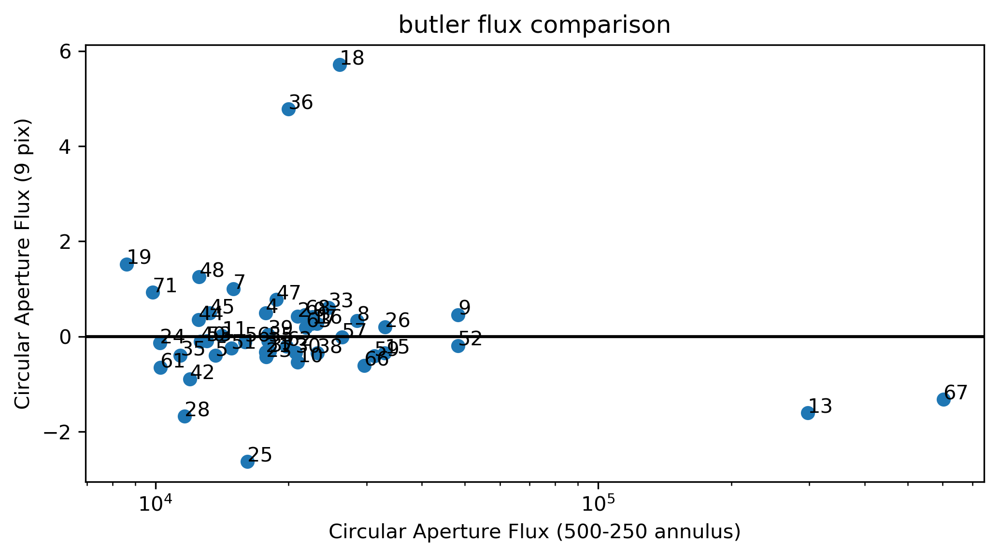

In [23]:
# 250-500 pixel annulus vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(annflux, r9flux)
for i, txt in enumerate(range(len(r9flux))):
    ax.annotate(txt, (annflux[i], r9flux[i]), clip_on=True)
plt.axhline(y=0, c='k')
# ax.set_xlim(0.003,0.175)
# ax.set_ylim(-0.025,0.025)
ax.set_xscale('log')
plt.xlabel('Circular Aperture Flux (500-250 annulus)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('butler flux comparison')
plt.show()

# Day 1.5 Notes

In order of importance / confusion:
* why are sky objects in the wings of bright sources being reported as positive? (A: calexp data, not pre-cal)
* why are some sky objects being placed in areas corresponding to a DETECTED mask footprint? (A: diff. calexp footprint)
* why are some sky object centroids significantly offset from their noise replace true centroids? (Unknown, but flagged)
* sky objects are un-necessarily clustered -> do not cover areas of interest for this study
* the total number of 'good' pixels used to determine circular aperture fluxes is not recorded (problematic at edges) -> requires after-the-fact calculation of circle edge proximity.

# Day 1.5 Update

* The sky object code does not have access to the DETECTION mask plane. Instead, it constructs a 'mocked up' detection mask plane based on detection footprints. We should check the difference between these two.
* Sky object centroid positions may move due to variable definition of centroid (e.g., is it modelled centroid?) - need to check this. 

In [24]:
# # Firefly: load Firefly server
# afwDisplay.setDefaultBackend('firefly')
# firefly = afwDisplay.Display(frame=1, url="https://lsst-demo.ncsa.illinois.edu/firefly/")
# firefly.getClient().display_url()

In [25]:
# # Firefly: patch plot
# firefly.mtv(coadd)
# for s in skyobjects0:
#     firefly.dot("o", s.getX(), s.getY(), size=8, ctype='yellow')
#     firefly.dot("o", s.getX(), s.getY(), size=50, ctype='yellow')

In [26]:
# # Firefly: modify look and feel
# # mpdict = {"DETECTED": "RED", 
# #           "DETECTED_NEGATIVE": "GREEN", 
# #           "BAD": "MAGENTA", 
# #           "NO_DATA": "YELLOW"}
# # mpdictfull = makemaskdict(mpdict, coadd.mask.getMaskPlaneDict())
# # firefly.setMaskPlaneColor(mpdictfull)
# # firefly.setDefaultImageColormap("sls-ds9")
# firefly.scale("asinh", np.quantile(coadd.image.array, 0.2), np.quantile(coadd.image.array, 0.8))
# firefly.setMaskTransparency(5)

In [27]:
# manual circ. ap. flux gen.
# 
# xslot = skyobjects0['slot_Centroid_x']
# yslot = skyobjects0['slot_Centroid_y']
# r9flux1 = skyobjectsnrf['base_CircularApertureFlux_9_0_instFlux']
# r250flux1 = skyobjectsnrf['base_CircularApertureFlux_250_0_instFlux']
# r500flux1 = skyobjectsnrf['base_CircularApertureFlux_500_0_instFlux']
xv, yv = np.meshgrid(np.arange(coadd.image.getBBox().getBeginX(),coadd.image.getBBox().getEndX(),1), 
                    np.arange(coadd.image.getBBox().getBeginY(),coadd.image.getBBox().getEndY(),1))

# loop
r9fluxpre = np.array([])
r250fluxpre = np.array([])
r500fluxpre = np.array([])
r9fluxpost = np.array([])
r250fluxpost = np.array([])
r500fluxpost = np.array([])
for x,y in zip(xnrf,ynrf):
    # determine 'good' pixels
    xvi = xv - x
    yvi = yv - y
    xyi = np.sqrt(((xvi)**2) + ((yvi)**2))
    g9 = np.where(xyi.flatten() <= 9)
    g250 = np.where(xyi.flatten() <= 250)
    g500 = np.where(xyi.flatten() <= 500)
    # calculate 'good' flux
    v9pre = np.sum(coadd.image.array.flatten()[g9])
    v250pre = np.sum(coadd.image.array.flatten()[g250])
    v500pre = np.sum(coadd.image.array.flatten()[g500])
    v9post = np.sum(calexp.image.array.flatten()[g9])
    v250post = np.sum(calexp.image.array.flatten()[g250])
    v500post = np.sum(calexp.image.array.flatten()[g500])
    # update outputs
    r9fluxpre = np.append(r9fluxpre, v9pre)
    r250fluxpre = np.append(r250fluxpre, v250pre)
    r500fluxpre = np.append(r500fluxpre, v500pre)
    r9fluxpost = np.append(r9fluxpost, v9post)
    r250fluxpost = np.append(r250fluxpost, v250post)
    r500fluxpost = np.append(r500fluxpost, v500post)
annfluxpre = r500fluxpre - r250fluxpre
annfluxpost = r500fluxpost - r250fluxpost

In [28]:
# import astropy.table as aptable
# aptable.QTable([r500flux, r500fluxpost])

In [29]:
# # commands for DS9 / R local analysis
# fitsout = ('/project/lskelvin/apertures/t' + str(dataid['tract']) + 'p' + str(dataid['patch']) + 
#            'f' + str(dataid['filter']) + '.fits')
# coadd.writeFitsWithOptions(dest=fitsout, options=None)
# fitsout = '/project/lskelvin/apertures/tempmask.fits'
# calexp.writeFitsWithOptions(dest=fitsout, options=None)

In [30]:
# local analysis
cid = 20
print('object ID:', cid)
print('NRF x y:', xnrf[cid]-coadd.image.getBBox().getBeginX()+1, ynrf[cid]-coadd.image.getBBox().getBeginY()+1)
print('NRT x y:', xnrt[cid]-coadd.image.getBBox().getBeginX()+1, ynrt[cid]-coadd.image.getBBox().getBeginY()+1)
print('9 px flux butler:', r9flux[cid])
print('9 px flux manual:', r9fluxpost[cid])
print('250 px flux butler:', r250flux[cid])
print('259 px flux manual:', r250fluxpost[cid])
print('500 px flux butler:', r500flux[cid])
print('500 px flux manual:', r500fluxpost[cid])

object ID: 20
NRF x y: 3727.0 2243.0
NRT x y: 3727.0 2243.0
9 px flux butler: -14.433024406433105
9 px flux manual: -14.3733491897583
250 px flux butler: 245744.45666168595
259 px flux manual: 245744.46875
500 px flux butler: nan
500 px flux manual: 271046.09375


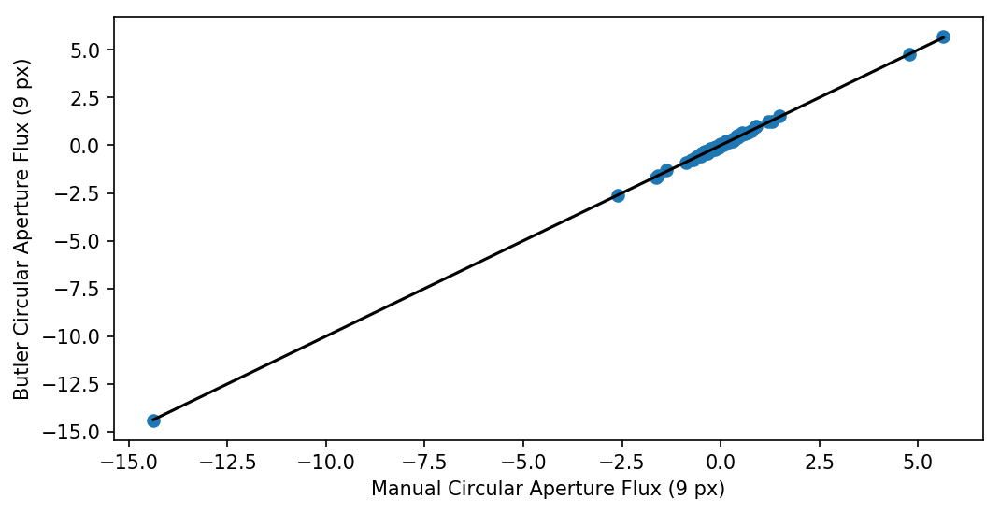

In [31]:
# 9 pixel flux comparison plots
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(r9fluxpost, r9flux)
# plt.axhline(y=0, c='k')
# ax.set_xlim(-3, 20)
# ax.set_ylim(-3, 3)
# ax.set_xscale('log')
plt.xlabel('Manual Circular Aperture Flux (9 px)')
plt.ylabel('Butler Circular Aperture Flux (9 px)')
xx = np.linspace(np.min(r9fluxpost),np.max(r9fluxpost),100)
yy = 1 * xx
plt.plot(xx,yy,c='k')
# ax.text(175000, 90000, "9 px")
plt.show()

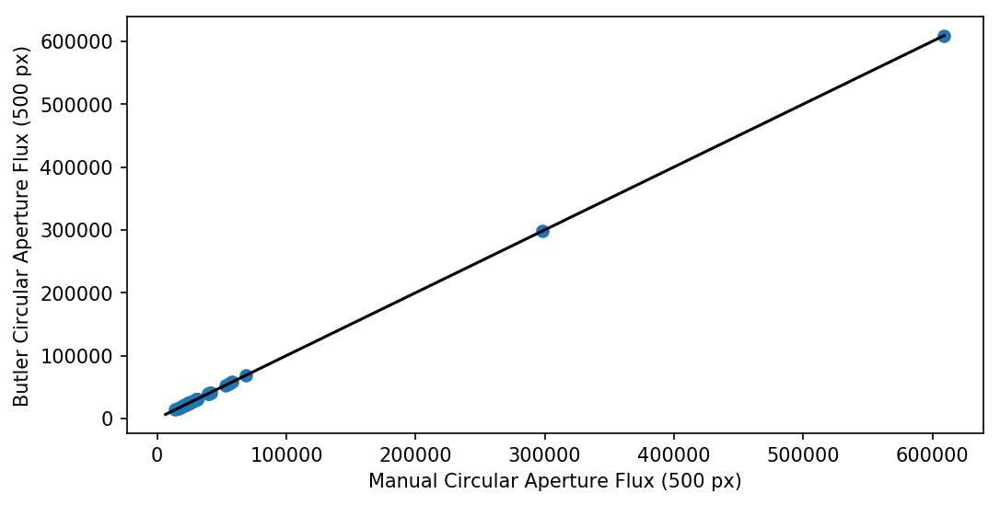

In [32]:
# 500 pixel flux comparison plots
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(r500fluxpost, r500flux)
# plt.axhline(y=0, c='k')
# ax.set_xlim(-3, 200000)
# ax.set_ylim(-3, 100000)
# ax.set_xscale('log')
plt.xlabel('Manual Circular Aperture Flux (500 px)')
plt.ylabel('Butler Circular Aperture Flux (500 px)')
xx = np.linspace(np.min(r500fluxpost),np.max(r500fluxpost),100)
yy = 1 * xx
plt.plot(xx,yy,c='k')
# ax.text(175000, 90000, "500 px")
plt.show()

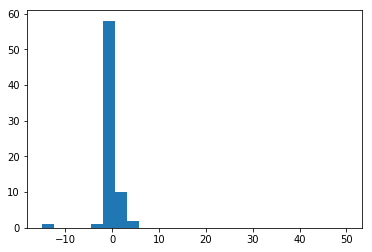

In [33]:
plt.hist(r9flux, bins=25, range=(-15,50))
plt.show()

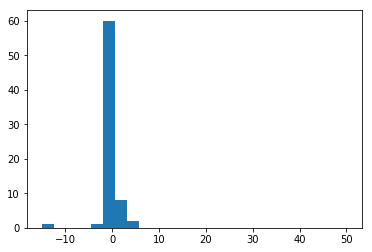

In [34]:
plt.hist(r9fluxpost, bins=25, range=(-15,50))
plt.show()

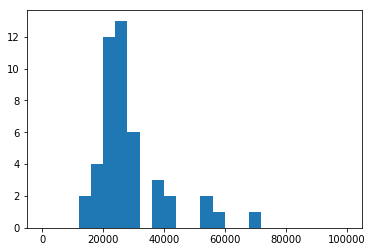

In [35]:
plt.hist(r500flux[~np.isnan(r500flux)], bins=25, range=(0,100000))
plt.show()

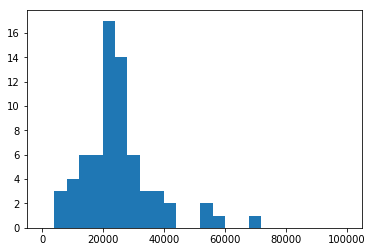

In [36]:
plt.hist(r500fluxpost, bins=25, range=(0,100000))
plt.show()

# Day 2.5 Notes

* sky object measurements are generated on deepCoadd_calexp's, not deepCoadd's!
* appears to be working, however, incomplete coverage of the sky and circular apertures overlapping with the edge and returning nans is causing problems.

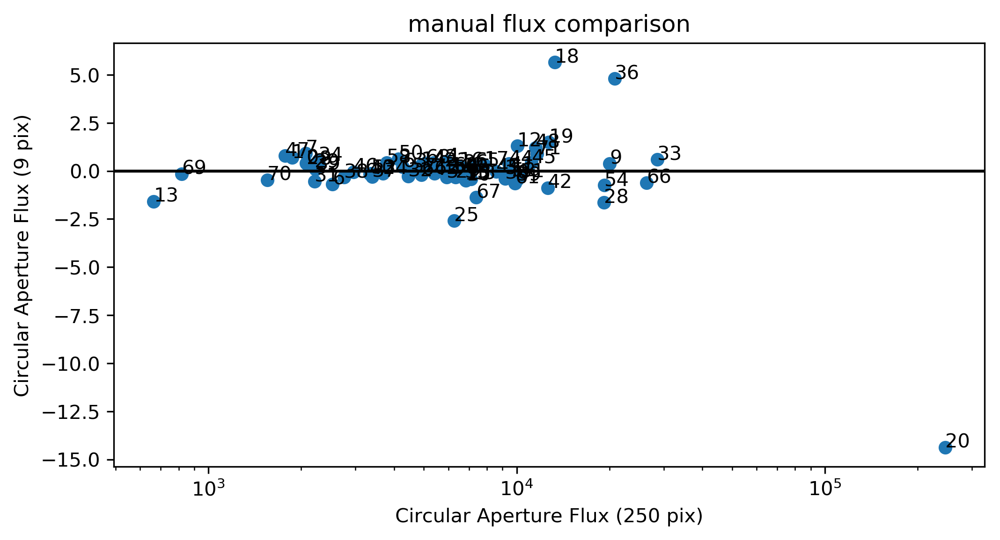

In [37]:
# 250 pixel vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(r250fluxpost, r9fluxpost)
for i, txt in enumerate(range(len(r9fluxpost))):
    ax.annotate(txt, (r250fluxpost[i], r9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
# ax.set_xlim(0.003,0.175)
# ax.set_ylim(-0.025,0.025)
ax.set_xscale('log')
plt.xlabel('Circular Aperture Flux (250 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('manual flux comparison')
plt.show()

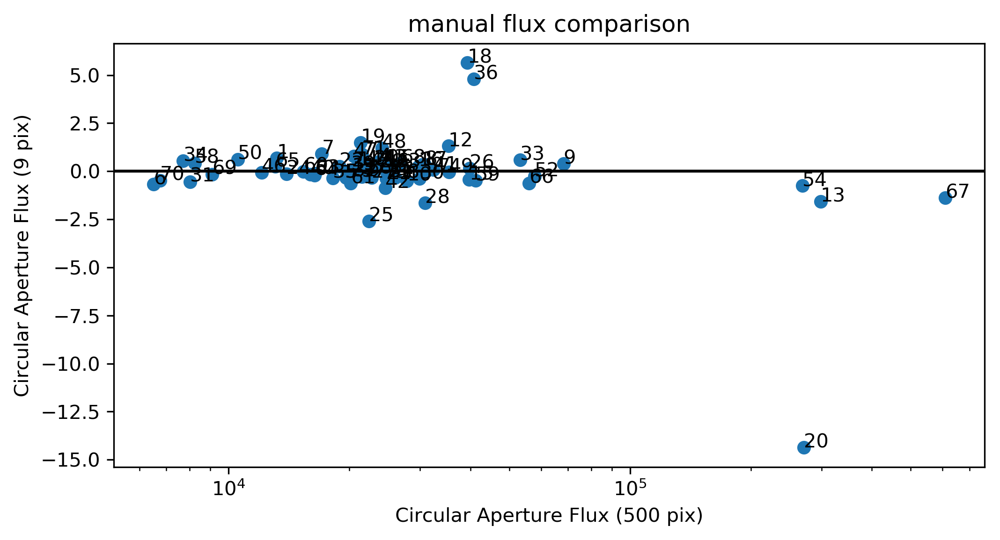

In [38]:
# 500 pixel vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(r500fluxpost, r9fluxpost)
for i, txt in enumerate(range(len(r9fluxpost))):
    ax.annotate(txt, (r500fluxpost[i], r9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
# ax.set_xlim(0.003,0.175)
# ax.set_ylim(-0.025,0.025)
ax.set_xscale('log')
plt.xlabel('Circular Aperture Flux (500 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('manual flux comparison')
plt.show()

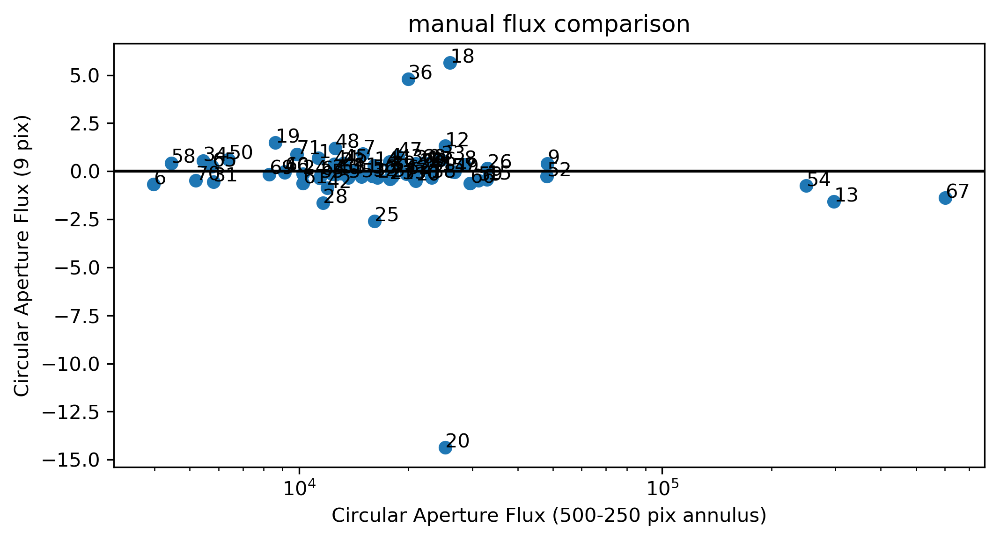

In [39]:
# 500-250 annulus vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(annfluxpost, r9fluxpost)
for i, txt in enumerate(range(len(r9fluxpost))):
    ax.annotate(txt, (annfluxpost[i], r9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
# ax.set_xlim(0.003,0.175)
# ax.set_ylim(-0.025,0.025)
ax.set_xscale('log')
plt.xlabel('Circular Aperture Flux (500-250 pix annulus)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('manual flux comparison')
plt.show()

In [40]:
# mask definition
print(calexp.mask.getMaskPlaneDict())
# extract mask GFEDCBA9876543210
bitmask = int('00000000101100001', 2)
# notmasked = (np.flip(calexp.mask.array,0) & bitmask) == 0
notmasked = (calexp.mask.array & bitmask) == 0
maskplane = notmasked*1

{'BAD': 0, 'BRIGHT_OBJECT': 9, 'CLIPPED': 10, 'CR': 3, 'CROSSTALK': 11, 'DETECTED': 5, 'DETECTED_NEGATIVE': 6, 'EDGE': 4, 'INEXACT_PSF': 12, 'INTRP': 2, 'NOT_DEBLENDED': 13, 'NO_DATA': 8, 'REJECTED': 14, 'SAT': 1, 'SENSOR_EDGE': 15, 'SUSPECT': 7, 'UNMASKEDNAN': 16}


In [41]:
# user defined grid points
xlo = coadd.image.getBBox().getBeginX()
xhi = coadd.image.getBBox().getEndX()
ylo = coadd.image.getBBox().getBeginY()
yhi = coadd.image.getBBox().getEndY()
xsteps = np.arange(xlo+50, xhi, 200)
ysteps = np.arange(ylo+50, yhi, 200)
xgrid, ygrid = np.meshgrid(xsteps, ysteps)
xgrid = xgrid.flatten()
ygrid = ygrid.flatten()

In [42]:
# apply mask
xgood = np.array([])
ygood = np.array([])
for x,y in zip(xgrid,ygrid):
    if maskplane[(x-xlo),(y-ylo)] == 1:
        xgood = np.append(xgood, x)
        ygood = np.append(ygood, y)
print('fraction of grid points used: ', len(xgood), '/', len(xgrid))

fraction of grid points used:  331 / 441


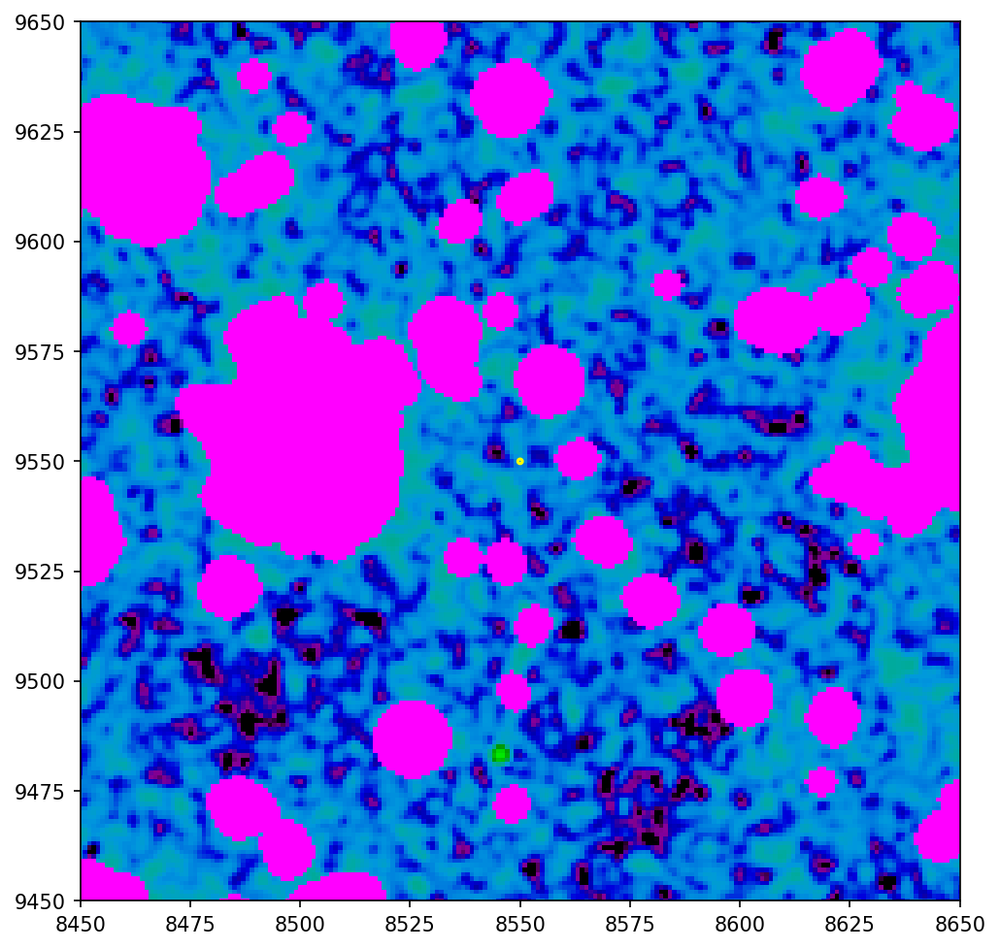

In [43]:
# calexp with grid points
%matplotlib inline
# custom color map
ncolors = 2
color_array = plt.get_cmap('spring')(range(ncolors))
color_array[:,-1] = np.linspace(1.0,0.0,ncolors)
map_object = matplotlib.colors.LinearSegmentedColormap.from_list(name='maskmap',colors=color_array)
plt.register_cmap(cmap=map_object)
# plot
fig = plt.figure(figsize=(8,8), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
img, lo, hi = imprep(np.flip(calexp.image.array, 0), scale=99.99, fwhm=3, lo=-0.01, hi=2)
extent = (calexp.image.getBBox().getBeginX()-0.5, calexp.image.getBBox().getEndX()-0.5, 
          calexp.image.getBBox().getBeginY()-0.5, calexp.image.getBBox().getEndY()-0.5)
plt.imshow(img, extent=extent, cmap="nipy_spectral")
plt.imshow(np.flip(maskplane,0), extent=extent, cmap='maskmap')
plt.scatter(x=ygood, y=xgood, s=5, facecolors='none', edgecolors='yellow', linewidth=1.5)
# for i, txt in enumerate(range(len(x0))):
#     ax.annotate(txt, (x0[i], y0[i]), color='black', fontsize=16, clip_on=True)
cid = 51
zoom = 100
plt.xlim(ygood[cid]-zoom,ygood[cid]+zoom)
plt.ylim(xgood[cid]-zoom,xgood[cid]+zoom)
# plt.xlim(xlo,xlo+10)
# plt.ylim(ylo,ylo+10)
plt.show()

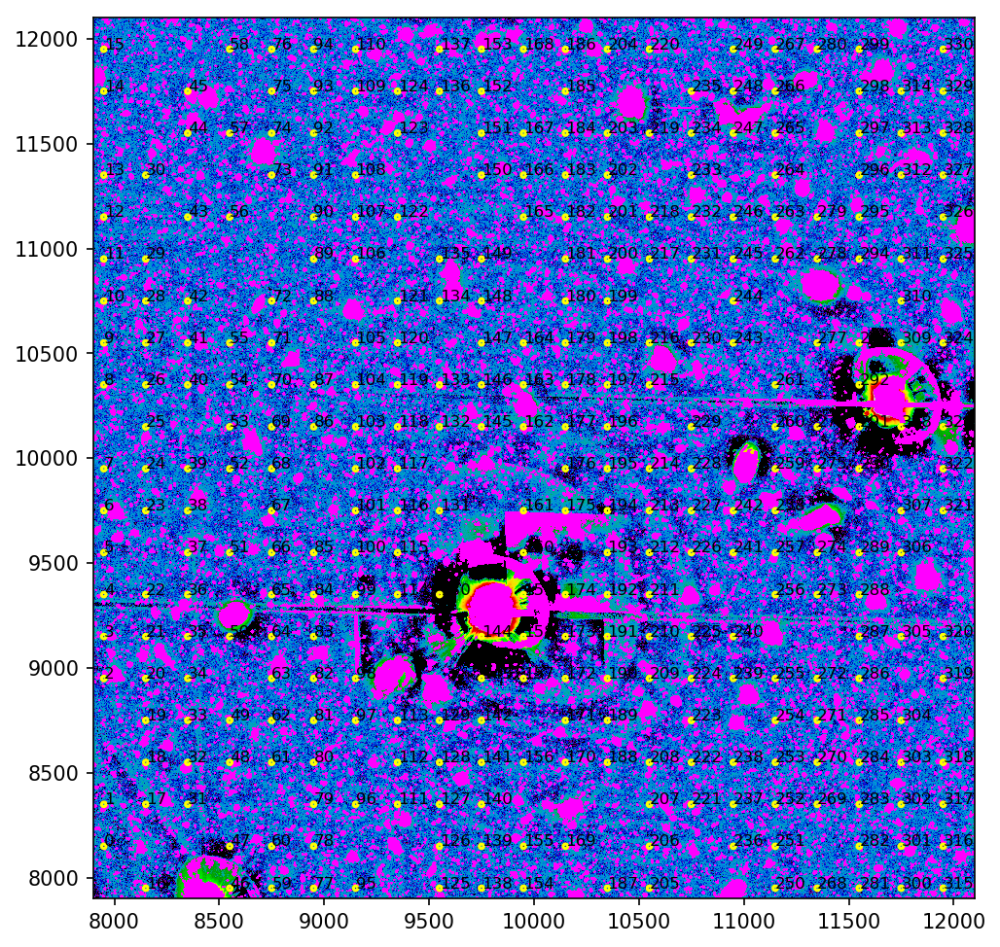

In [44]:
# calexp with grid points
%matplotlib inline
# custom color map
ncolors = 2
color_array = plt.get_cmap('spring')(range(ncolors))
color_array[:,-1] = np.linspace(1.0,0.0,ncolors)
map_object = matplotlib.colors.LinearSegmentedColormap.from_list(name='maskmap',colors=color_array)
plt.register_cmap(cmap=map_object)
# plot
fig = plt.figure(figsize=(8,8), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
img, lo, hi = imprep(np.flip(calexp.image.array, 0), scale=99.99, fwhm=3, lo=-0.01, hi=2)
extent = (calexp.image.getBBox().getBeginX()-0.5, calexp.image.getBBox().getEndX()-0.5, 
          calexp.image.getBBox().getBeginY()-0.5, calexp.image.getBBox().getEndY()-0.5)
plt.imshow(img, extent=extent, cmap="nipy_spectral")
plt.imshow(np.flip(maskplane,0), extent=extent, cmap='maskmap')
plt.scatter(x=ygood, y=xgood, s=5, facecolors='none', edgecolors='yellow', linewidth=1.5)
for i, txt in enumerate(range(len(xgood))):
    ax.annotate(txt, (ygood[i], xgood[i]), color='black', fontsize=8, clip_on=True)
plt.show()

In [45]:
# generate user stats with custom grid
from astropy.stats import sigma_clip as sc
xv, yv = np.meshgrid(np.arange(coadd.image.getBBox().getBeginX(), coadd.image.getBBox().getEndX(), 1), 
                     np.arange(coadd.image.getBBox().getBeginY(), coadd.image.getBBox().getEndY(), 1))
u9fluxpre = np.array([])
u250fluxpre = np.array([])
u500fluxpre = np.array([])
u9fluxpost = np.array([])
u250fluxpost = np.array([])
u500fluxpost = np.array([])
u9fluxpremed = np.array([])
u250fluxpremed = np.array([])
u500fluxpremed = np.array([])
u9fluxpostmed = np.array([])
u250fluxpostmed = np.array([])
u500fluxpostmed = np.array([])
for x,y in zip(xgood,ygood):
    # determine 'good' pixels
    xvi = xv - y
    yvi = yv - x
    xyi = np.sqrt(((xvi)**2) + ((yvi)**2))
    g9 = np.where(xyi.flatten() <= 9)
    g250 = np.where(xyi.flatten() <= 250)
    g500 = np.where(xyi.flatten() <= 500)
    # calculate 'good' flux
    v9pre = np.sum(coadd.image.array.flatten()[g9])
    v250pre = np.sum(coadd.image.array.flatten()[g250])
    v500pre = np.sum(coadd.image.array.flatten()[g500])
    v9post = np.sum(calexp.image.array.flatten()[g9])
    v250post = np.sum(calexp.image.array.flatten()[g250])
    v500post = np.sum(calexp.image.array.flatten()[g500])
    v9premed = np.nanmedian(sc(coadd.image.array.flatten()[g9],sigma=3,masked=False))
    v250premed = np.nanmedian(sc(coadd.image.array.flatten()[g250],sigma=3,masked=False))
    v500premed = np.nanmedian(sc(coadd.image.array.flatten()[g500],sigma=3,masked=False))
    v9postmed = np.nanmedian(sc(calexp.image.array.flatten()[g9],sigma=3,masked=False))
    v250postmed = np.nanmedian(sc(calexp.image.array.flatten()[g250],sigma=3,masked=False))
    v500postmed = np.nanmedian(sc(calexp.image.array.flatten()[g500],sigma=3,masked=False))
    # update outputs
    u9fluxpre = np.append(u9fluxpre, v9pre)
    u250fluxpre = np.append(u250fluxpre, v250pre)
    u500fluxpre = np.append(u500fluxpre, v500pre)
    u9fluxpost = np.append(u9fluxpost, v9post)
    u250fluxpost = np.append(u250fluxpost, v250post)
    u500fluxpost = np.append(u500fluxpost, v500post)
    u9fluxpremed = np.append(u9fluxpremed, v9premed)
    u250fluxpremed = np.append(u250fluxpremed, v250premed)
    u500fluxpremed = np.append(u500fluxpremed, v500premed)
    u9fluxpostmed = np.append(u9fluxpostmed, v9postmed)
    u250fluxpostmed = np.append(u250fluxpostmed, v250postmed)
    u500fluxpostmed = np.append(u500fluxpostmed, v500postmed)
uannfluxpre = u500fluxpre - u250fluxpre
uannfluxpost = u500fluxpost - u250fluxpost

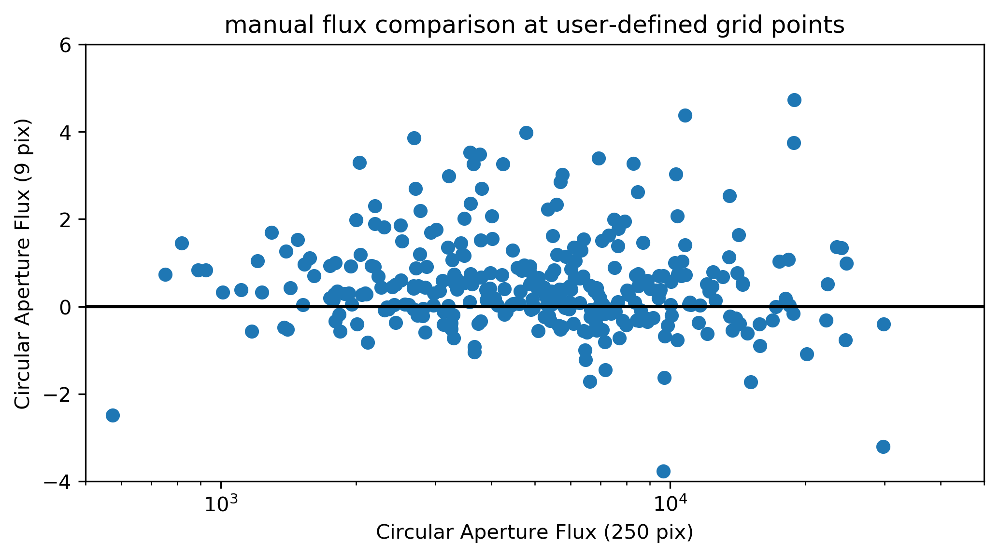

In [46]:
# 250 pixel vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(u250fluxpost, u9fluxpost)
# for i, txt in enumerate(range(len(u9fluxpost))):
#     ax.annotate(txt, (u250fluxpost[i], u9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
ax.set_xlim(5e2,5e4)
ax.set_ylim((-4,6))
ax.set_xscale('log')
plt.xlabel('Circular Aperture Flux (250 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('manual flux comparison at user-defined grid points')
plt.show()

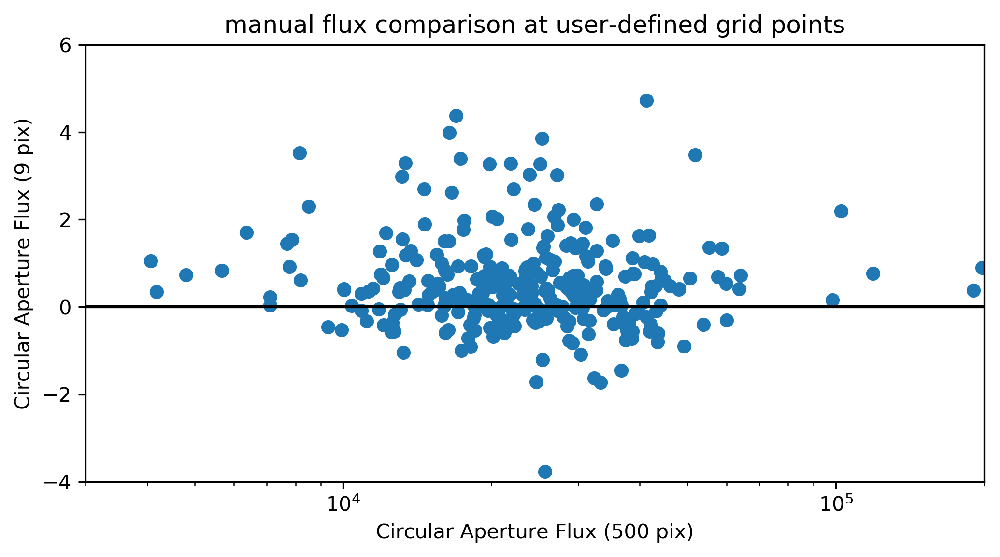

In [47]:
# 500 pixel vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(u500fluxpost, u9fluxpost)
# for i, txt in enumerate(range(len(u9fluxpost))):
#     ax.annotate(txt, (u500fluxpost[i], u9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
ax.set_xlim(3e3,2e5)
ax.set_ylim((-4,6))
ax.set_xscale('log')
plt.xlabel('Circular Aperture Flux (500 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('manual flux comparison at user-defined grid points')
plt.show()

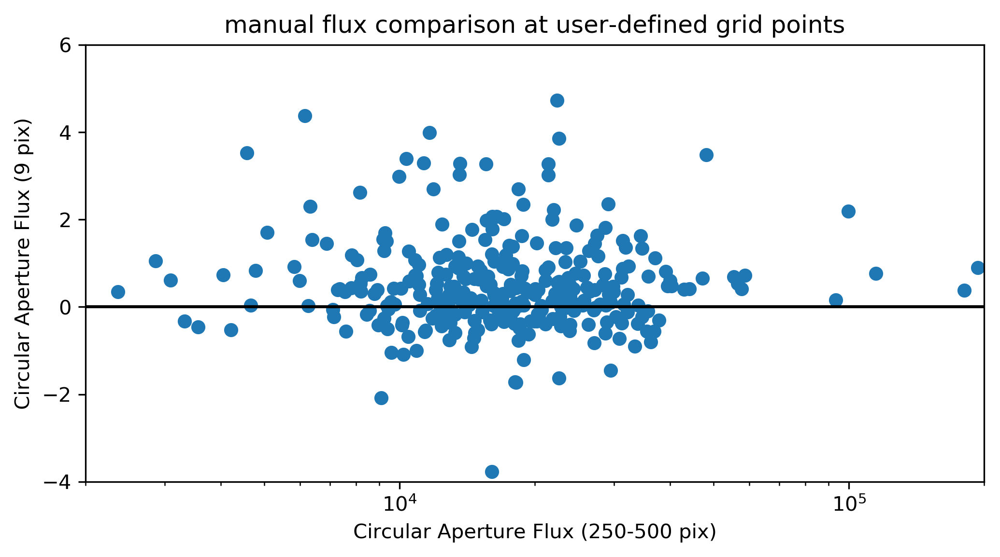

In [48]:
# annulus vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(uannfluxpost, u9fluxpost)
# for i, txt in enumerate(range(len(u9fluxpost))):
#     ax.annotate(txt, (uannfluxpost[i], u9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
ax.set_xlim(2e3,2e5)
ax.set_ylim((-4,6))
ax.set_xscale('log')
plt.xlabel('Circular Aperture Flux (250-500 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('manual flux comparison at user-defined grid points')
plt.show()

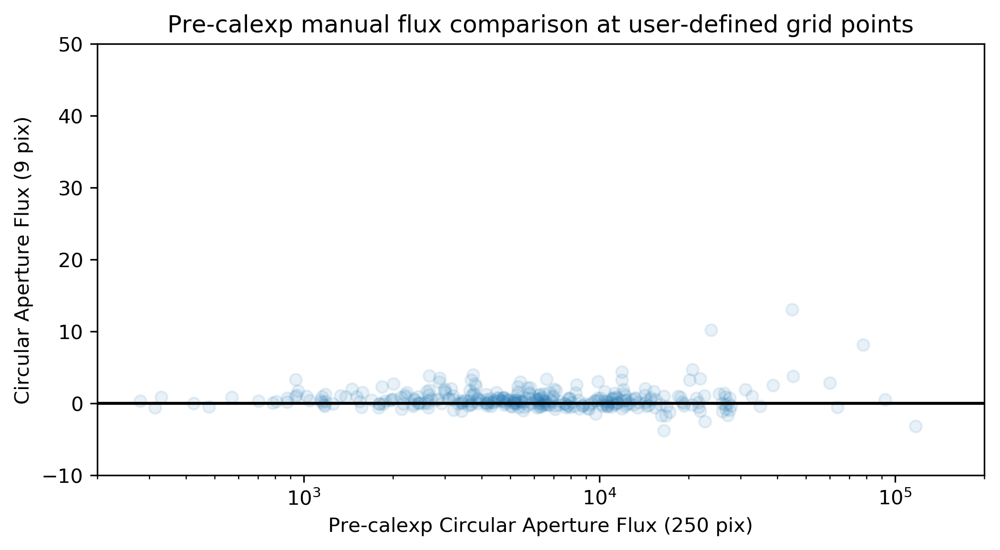

In [49]:
# 250 pixel vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(u250fluxpre, u9fluxpost, alpha=0.1)
# for i, txt in enumerate(range(len(u9fluxpost))):
#     ax.annotate(txt, (u250fluxpre[i], u9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
ax.set_xlim(2e2,2e5)
ax.set_ylim((-10,50))
ax.set_xscale('log')
plt.xlabel('Pre-calexp Circular Aperture Flux (250 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('Pre-calexp manual flux comparison at user-defined grid points')
plt.show()

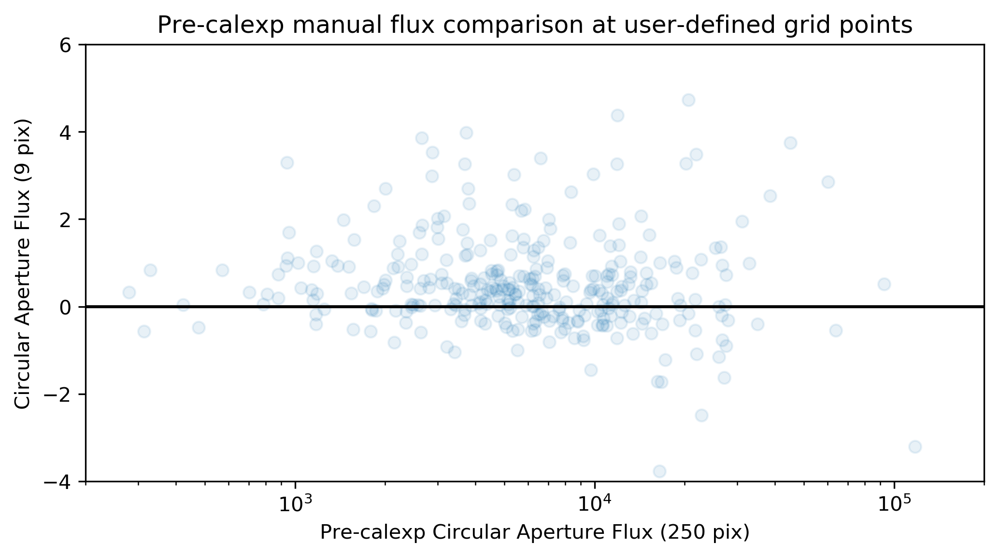

In [50]:
# 250 pixel vs. 9 pixel plot ZOOM
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(u250fluxpre, u9fluxpost, alpha=0.1)
# for i, txt in enumerate(range(len(u9fluxpost))):
#     ax.annotate(txt, (u250fluxpost[i], u9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
ax.set_xlim(2e2,2e5)
ax.set_ylim((-4,6))
ax.set_xscale('log')
plt.xlabel('Pre-calexp Circular Aperture Flux (250 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('Pre-calexp manual flux comparison at user-defined grid points')
plt.show()

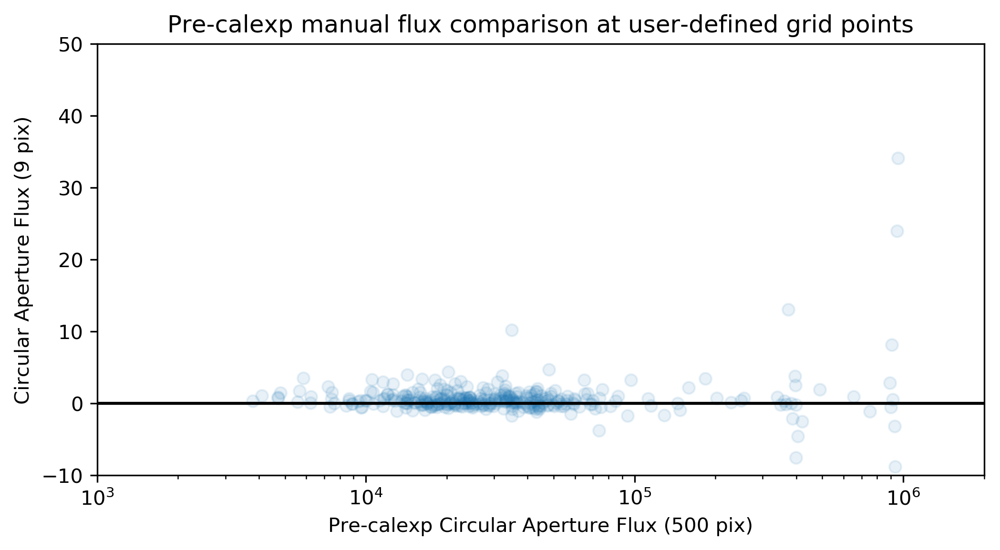

In [51]:
# 500 pixel vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(u500fluxpre, u9fluxpost, alpha=0.1)
# for i, txt in enumerate(range(len(u9fluxpost))):
#     ax.annotate(txt, (u500fluxpre[i], u9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
ax.set_xlim(1e3,2e6)
ax.set_ylim((-10,50))
ax.set_xscale('log')
plt.xlabel('Pre-calexp Circular Aperture Flux (500 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('Pre-calexp manual flux comparison at user-defined grid points')
plt.show()

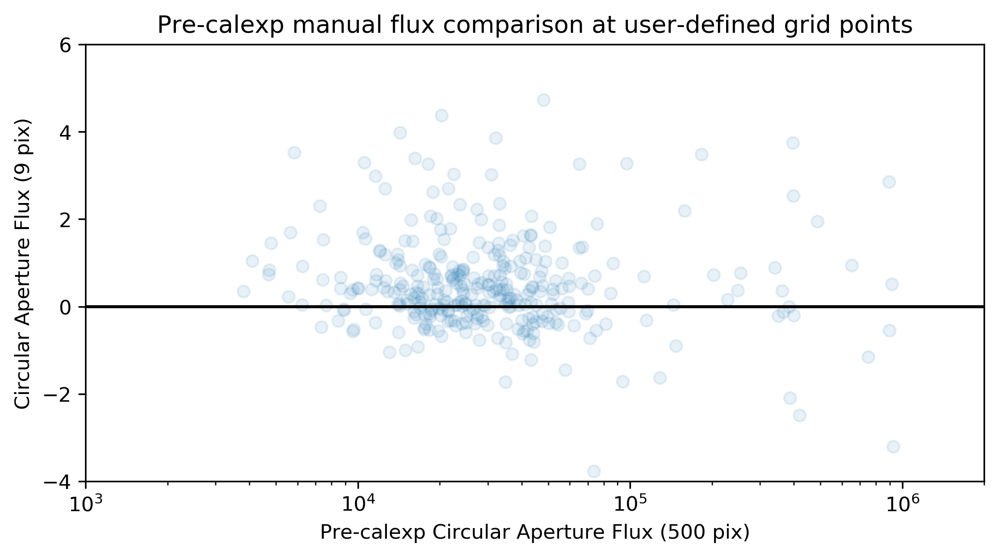

In [52]:
# 500 pixel vs. 9 pixel plot ZOOM
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(u500fluxpre, u9fluxpost, alpha=0.1)
# for i, txt in enumerate(range(len(u9fluxpost))):
#     ax.annotate(txt, (u500fluxpre[i], u9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
ax.set_xlim(1e3,2e6)
ax.set_ylim((-4,6))
ax.set_xscale('log')
plt.xlabel('Pre-calexp Circular Aperture Flux (500 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('Pre-calexp manual flux comparison at user-defined grid points')
plt.show()

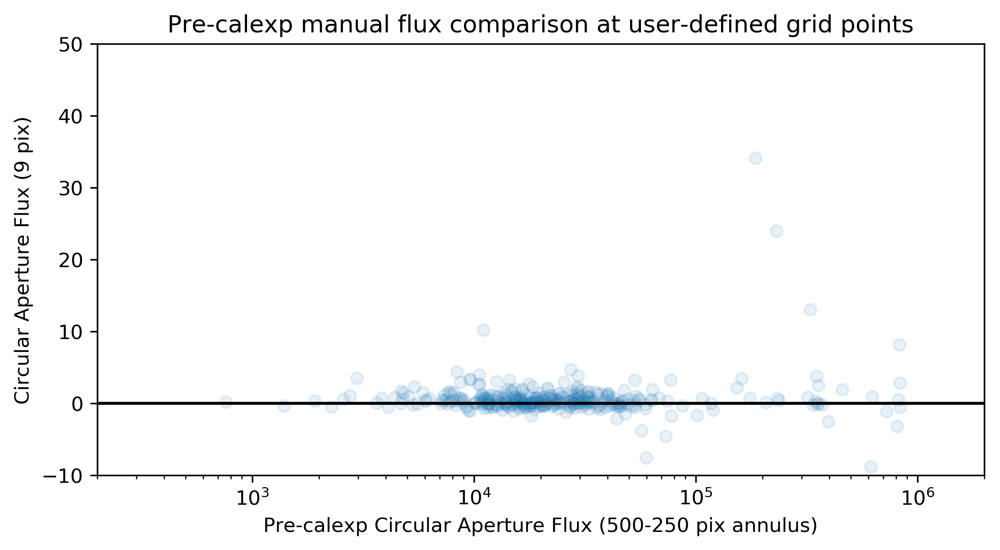

In [53]:
# annulus vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(uannfluxpre, u9fluxpost, alpha=0.1)
# for i, txt in enumerate(range(len(u9fluxpost))):
#     ax.annotate(txt, (uannfluxpre[i], u9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
ax.set_xlim(2e2,2e6)
ax.set_ylim((-10,50))
ax.set_xscale('log')
plt.xlabel('Pre-calexp Circular Aperture Flux (500-250 pix annulus)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('Pre-calexp manual flux comparison at user-defined grid points')
plt.show()

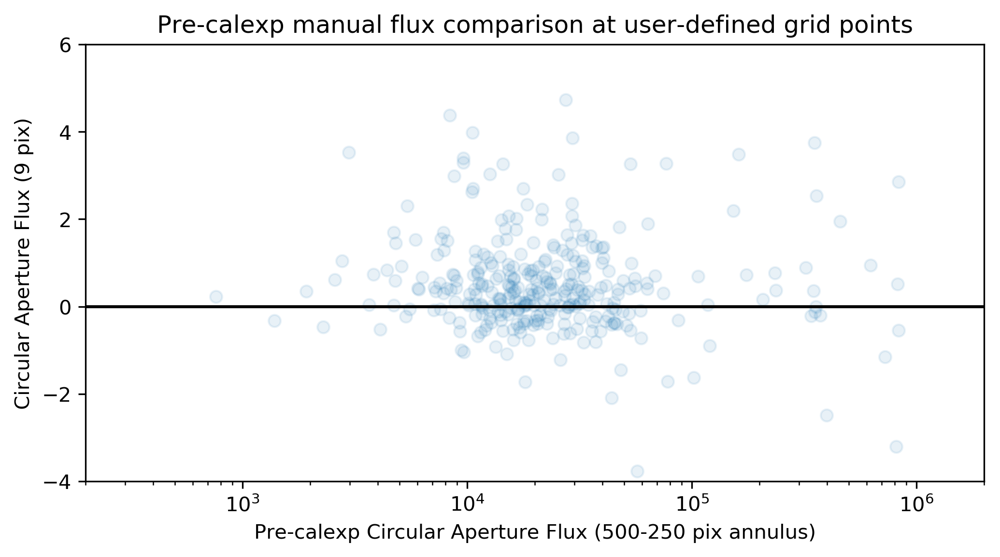

In [54]:
# annulus vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(uannfluxpre, u9fluxpost, alpha=0.1)
# for i, txt in enumerate(range(len(u9fluxpost))):
#     ax.annotate(txt, (uannfluxpre[i], u9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
ax.set_xlim(2e2,2e6)
ax.set_ylim((-4,6))
ax.set_xscale('log')
plt.xlabel('Pre-calexp Circular Aperture Flux (500-250 pix annulus)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('Pre-calexp manual flux comparison at user-defined grid points')
plt.show()

# So, does this method work?

Yes, but. Yes in that a signal is there, but, it's very noisy. Further refinement or an alternative method may be preferable.

In [55]:
# running median in 250 data
from astropy.stats import sigma_clip as sc
old = np.seterr(invalid='ignore')
xx = np.log10(u250fluxpost)
yy = u9fluxpost
# xstep = 0.1
# xrunmed = np.arange(np.log10(1e2), np.log10(1e7), xstep)
# yrunmed = np.array([])
# for xbin in xrunmed:
#     warnings.simplefilter("ignore", category=RuntimeWarning)
#     ids = np.where((xx > (xbin-(xstep/2))) & (xx < (xbin+(xstep/2))))
#     dat = sc(yy[ids], sigma=1.5, masked=False)
#     yrunmed = np.append(yrunmed, np.nanmedian(dat))
# xrunmed = 10**xrunmed
oo = xx.argsort()
xxx = xx[oo]
yyy = yy[oo]
bidedges = np.linspace(0, len(xxx), 20)
xrunmed = np.array([])
yrunmed = np.array([])
for first,last in zip(bidedges[:-1],bidedges[1:]):
    warnings.simplefilter("ignore", category=RuntimeWarning)
    ids = np.arange(int(first),int(last),1)
    dat = sc(yyy[ids], sigma=1.5, masked=False)
    yrunmed = np.append(yrunmed, np.nanmedian(dat))
    xrunmed = np.append(xrunmed, np.nanmedian(xxx[ids]))
xrunmed = 10**xrunmed

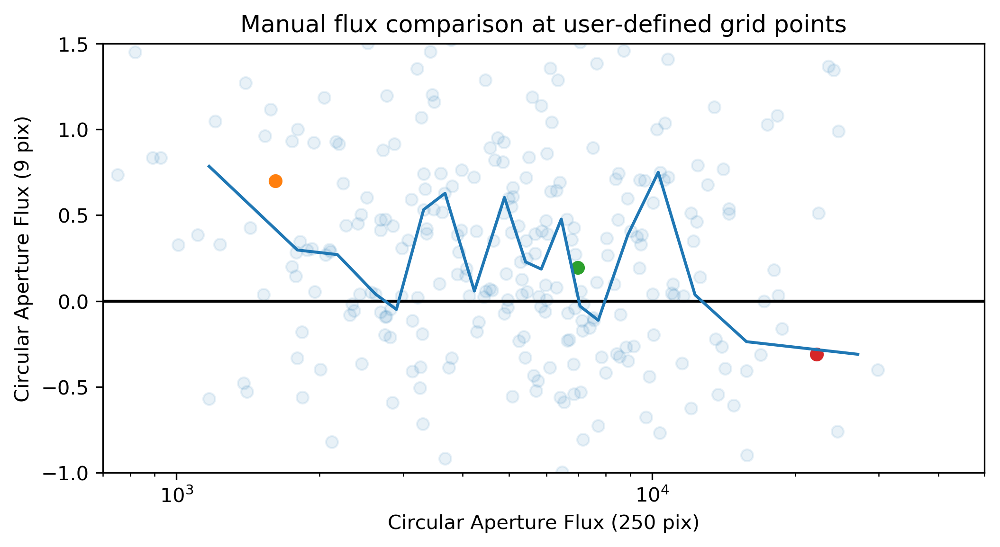

In [56]:
# 250 pixel vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(u250fluxpost, u9fluxpost, alpha=0.1)
# for i, txt in enumerate(range(len(u9fluxpost))):
#     ax.annotate(txt, (u250fluxpost[i], u9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
ax.set_xlim(7e2,5e4)
ax.set_ylim((-1,1.5))
ax.set_xscale('log')
plt.xlabel('Circular Aperture Flux (250 pix)')
plt.ylabel('Circular Aperture Flux (9 pix)')
plt.title('Manual flux comparison at user-defined grid points')
plt.plot(xrunmed, yrunmed)
# objects of interest
cid1 = 176
cid2 = 185
cid3 = 260
plt.scatter(u250fluxpost[cid1], u9fluxpost[cid1])
plt.scatter(u250fluxpost[cid2], u9fluxpost[cid2])
plt.scatter(u250fluxpost[cid3], u9fluxpost[cid3])
plt.show()

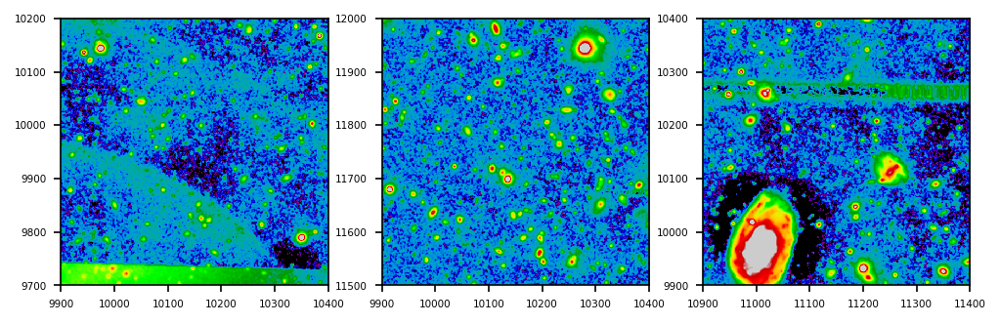

In [57]:
# example objects
%matplotlib inline
extent = (calexp.image.getBBox().getBeginX()-0.5, calexp.image.getBBox().getEndX()-0.5, 
          calexp.image.getBBox().getBeginY()-0.5, calexp.image.getBBox().getEndY()-0.5)
zoom = 250
fig = plt.figure(figsize=(8,8), dpi=150, facecolor='w', edgecolor='k')
img, lo, hi = imprep(np.flip(calexp.image.array, 0), scale=99.99, fwhm=3, lo=-0.01, hi=2)
ax1 = fig.add_subplot(131)
ax1.imshow(img, extent=extent, cmap="nipy_spectral")
ax1.set_xlim(ygood[cid1]-zoom,ygood[cid1]+zoom)
ax1.set_ylim(xgood[cid1]-zoom,xgood[cid1]+zoom)
ax1.tick_params(axis='both', which='major', labelsize=5)
ax2 = fig.add_subplot(132)
ax2.imshow(img, extent=extent, cmap="nipy_spectral")
ax2.set_xlim(ygood[cid2]-zoom,ygood[cid2]+zoom)
ax2.set_ylim(xgood[cid2]-zoom,xgood[cid2]+zoom)
ax2.tick_params(axis='both', which='major', labelsize=5)
ax3 = fig.add_subplot(133)
ax3.imshow(img, extent=extent, cmap="nipy_spectral")
ax3.set_xlim(ygood[cid3]-zoom,ygood[cid3]+zoom)
ax3.set_ylim(xgood[cid3]-zoom,xgood[cid3]+zoom)
ax3.tick_params(axis='both', which='major', labelsize=5)
plt.show()

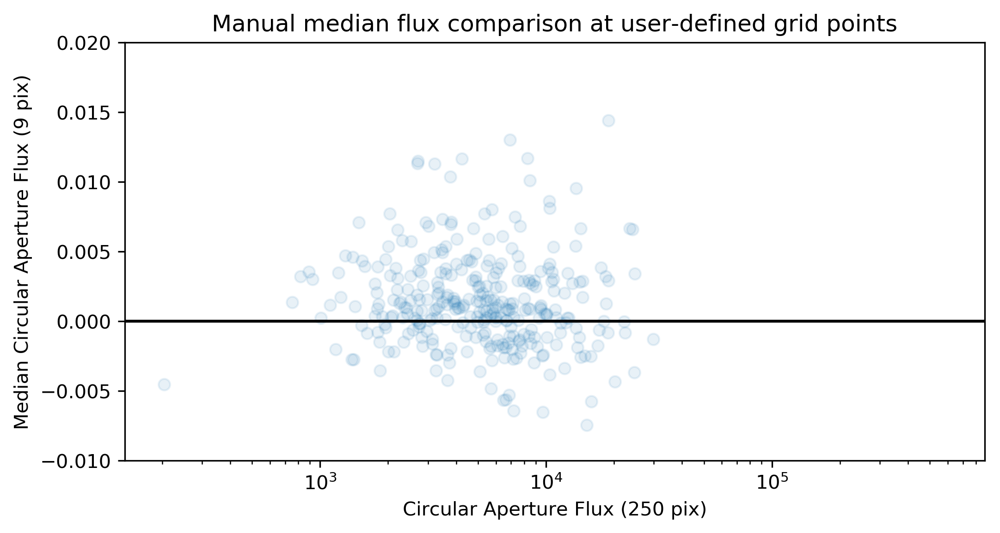

In [58]:
# 250 pixel vs. median 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(u250fluxpost, u9fluxpostmed, alpha=0.1)
# for i, txt in enumerate(range(len(u9fluxpost))):
#     ax.annotate(txt, (u250fluxpost[i], u9fluxpost[i]), clip_on=True)
plt.axhline(y=0, c='k')
# ax.set_xlim(0.001,0.006)
ax.set_ylim(-0.01,0.02)
ax.set_xscale('log')
plt.xlabel('Circular Aperture Flux (250 pix)')
plt.ylabel('Median Circular Aperture Flux (9 pix)')
plt.title('Manual median flux comparison at user-defined grid points')
# plt.plot(xrunmed, yrunmed)
plt.show()

# New Metrics?

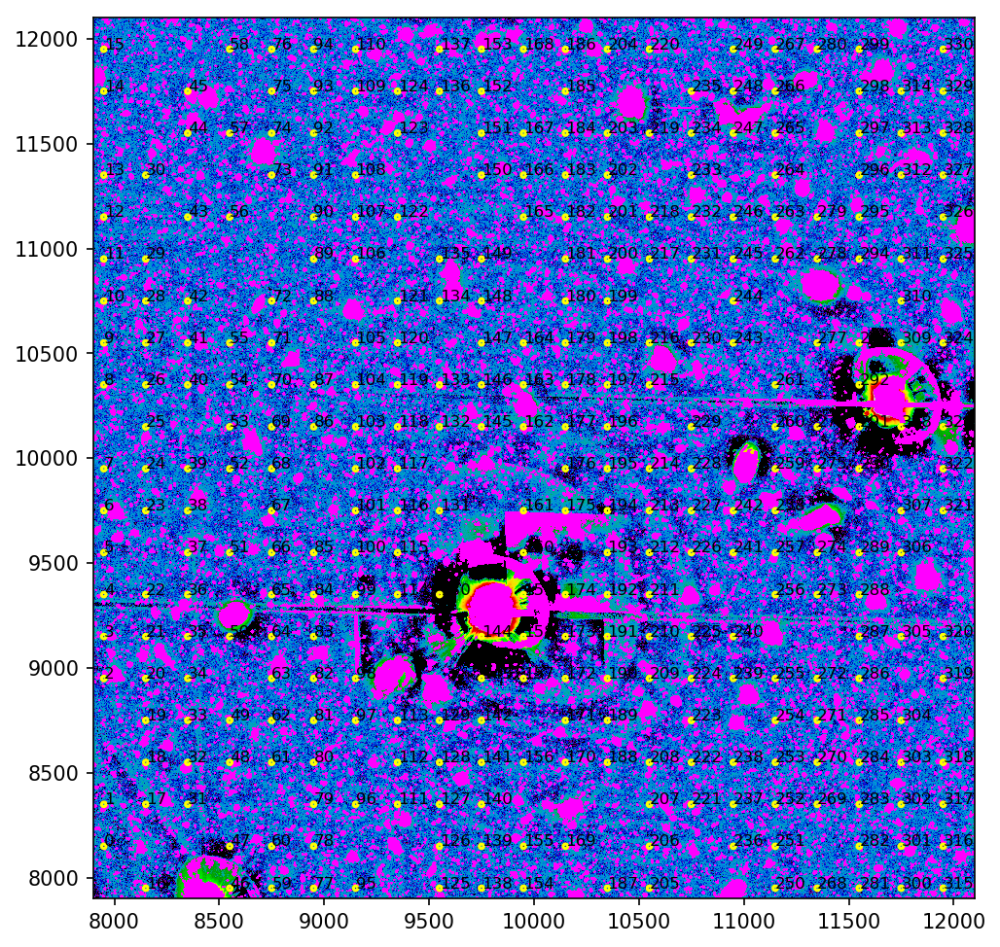

In [59]:
# calexp with grid points
%matplotlib inline
# custom color map
ncolors = 2
color_array = plt.get_cmap('spring')(range(ncolors))
color_array[:,-1] = np.linspace(1.0,0.0,ncolors)
map_object = matplotlib.colors.LinearSegmentedColormap.from_list(name='maskmap',colors=color_array)
plt.register_cmap(cmap=map_object)
# plot
fig = plt.figure(figsize=(8,8), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
img, lo, hi = imprep(np.flip(calexp.image.array, 0), scale=99.99, fwhm=3, lo=-0.01, hi=2)
extent = (calexp.image.getBBox().getBeginX()-0.5, calexp.image.getBBox().getEndX()-0.5, 
          calexp.image.getBBox().getBeginY()-0.5, calexp.image.getBBox().getEndY()-0.5)
plt.imshow(img, extent=extent, cmap="nipy_spectral")
plt.imshow(np.flip(maskplane,0), extent=extent, cmap='maskmap')
plt.scatter(x=ygood, y=xgood, s=5, facecolors='none', edgecolors='yellow', linewidth=1.5)
for i, txt in enumerate(range(len(xgood))):
    ax.annotate(txt, (ygood[i], xgood[i]), color='black', fontsize=8, clip_on=True)
plt.show()

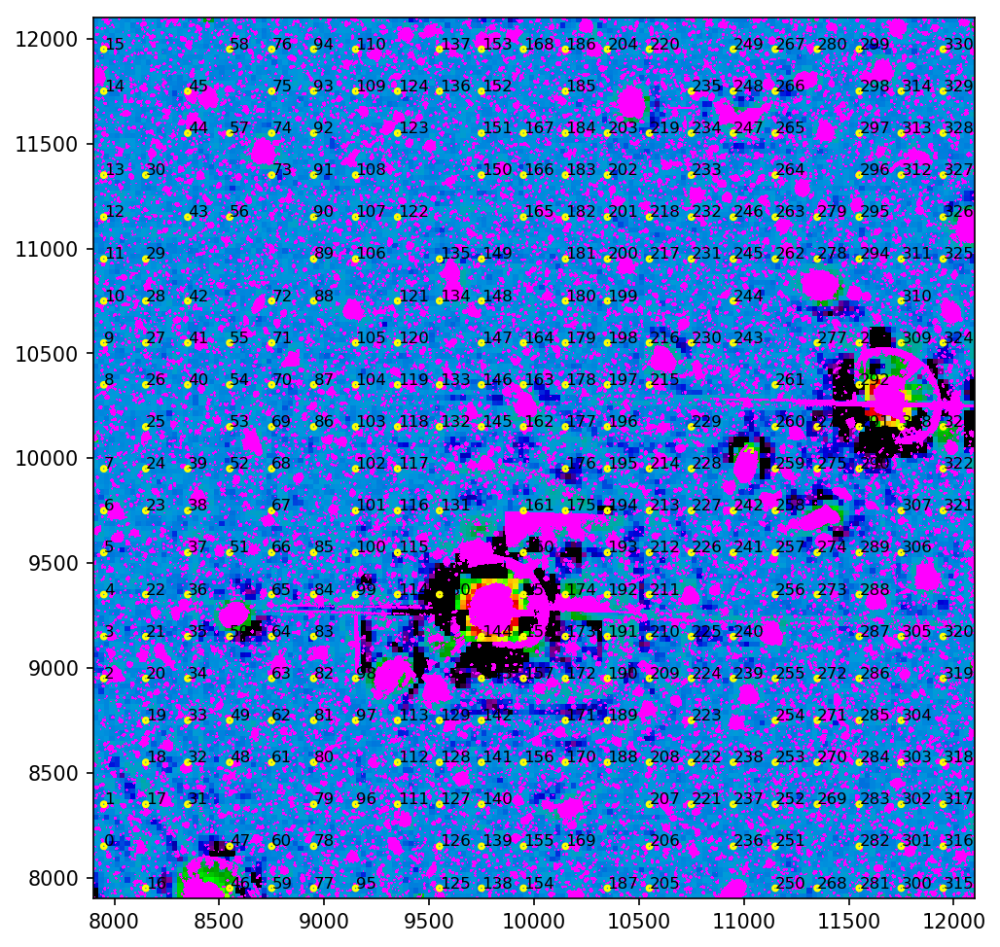

In [60]:
# rebin
%matplotlib inline
tempim = calexp.image.array * maskplane
rbcalexp = rebin(tempim, (168,168))
# plot
fig = plt.figure(figsize=(8,8), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
img, lo, hi = imprep(np.flip(rbcalexp, 0), scale=99.99, fwhm=0, lo=-0.01, hi=2)
extent = (calexp.image.getBBox().getBeginX()-0.5, calexp.image.getBBox().getEndX()-0.5, 
          calexp.image.getBBox().getBeginY()-0.5, calexp.image.getBBox().getEndY()-0.5)
plt.imshow(img, extent=extent, cmap="nipy_spectral")
plt.imshow(np.flip(maskplane,0), extent=extent, cmap='maskmap')
plt.scatter(x=ygood, y=xgood, s=5, facecolors='none', edgecolors='yellow', linewidth=1.5)
for i, txt in enumerate(range(len(xgood))):
    ax.annotate(txt, (ygood[i], xgood[i]), color='black', fontsize=8, clip_on=True)
plt.show()

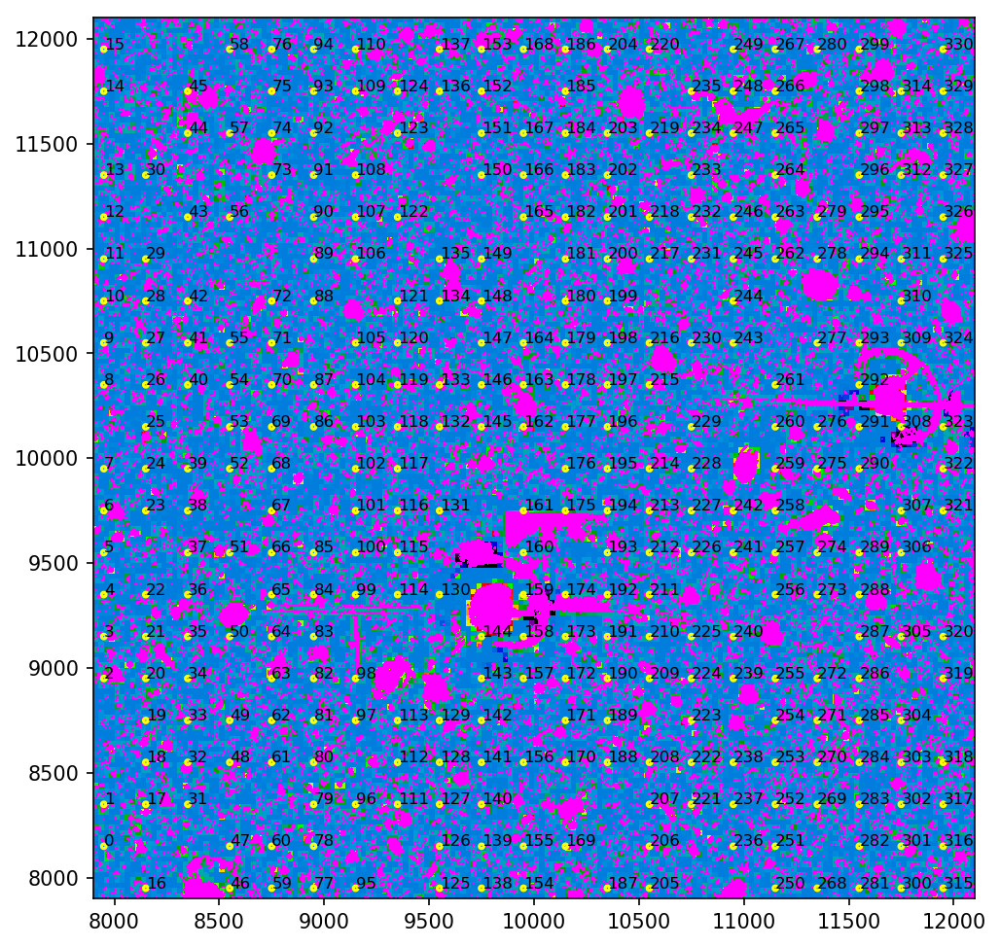

In [61]:
# rebin 2
%matplotlib inline
tempim = calexp.image.array *(1-maskplane)
rbcalexpsig = rebin(tempim, (168,168))
# plot
fig = plt.figure(figsize=(8,8), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
img, lo, hi = imprep(np.flip(rbcalexpsig, 0), scale=99.99, fwhm=0, lo=-0.01, hi=2)
extent = (calexp.image.getBBox().getBeginX()-0.5, calexp.image.getBBox().getEndX()-0.5, 
          calexp.image.getBBox().getBeginY()-0.5, calexp.image.getBBox().getEndY()-0.5)
plt.imshow(img, extent=extent, cmap="nipy_spectral")
plt.imshow(np.flip(maskplane,0), extent=extent, cmap='maskmap')
plt.scatter(x=ygood, y=xgood, s=5, facecolors='none', edgecolors='yellow', linewidth=1.5)
for i, txt in enumerate(range(len(xgood))):
    ax.annotate(txt, (ygood[i], xgood[i]), color='black', fontsize=8, clip_on=True)
plt.show()

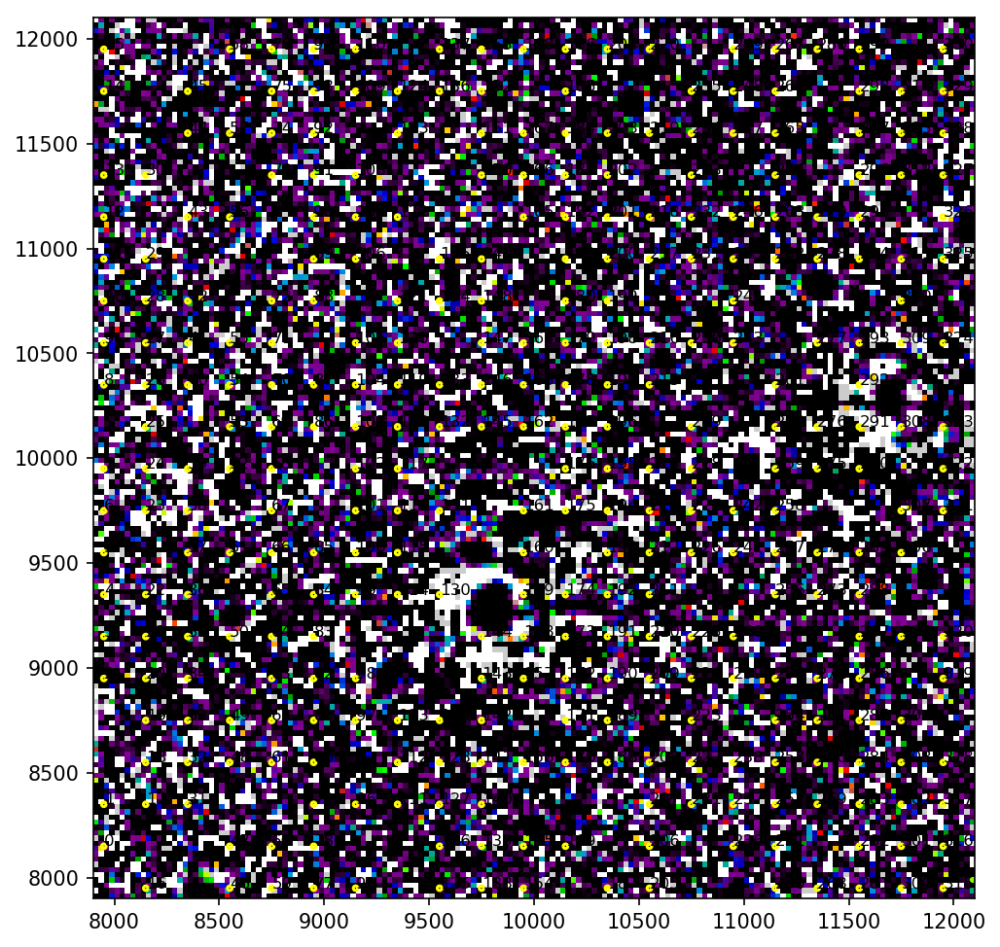

In [62]:
%matplotlib inline
# plot
fig = plt.figure(figsize=(8,8), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
img = np.flip((rbcalexp/rbcalexpsig), 0)
extent = (calexp.image.getBBox().getBeginX()-0.5, calexp.image.getBBox().getEndX()-0.5, 
          calexp.image.getBBox().getBeginY()-0.5, calexp.image.getBBox().getEndY()-0.5)
plt.imshow(img, extent=extent, cmap="nipy_spectral", vmin=0.1, vmax=10)
# plt.imshow(np.flip(maskplane,0), extent=extent, cmap='maskmap')
plt.scatter(x=ygood, y=xgood, s=5, facecolors='none', edgecolors='yellow', linewidth=1.5)
for i, txt in enumerate(range(len(xgood))):
    ax.annotate(txt, (ygood[i], xgood[i]), color='black', fontsize=8, clip_on=True)
plt.show()

# New Background

`detectCoaddSources.py /datasets/hsc/repo/ --calib /datasets/hsc/repo/CALIB/ --rerun RC/w_2020_03/DM-23121:private/lskelvin/background-detect--id tract=9813 filter=HSC-R patch=2,2 --config detection.background.binSize=64 detection.tempWideBackground.binSize=64`

`measureCoaddSources.py /datasets/hsc/repo --rerun private/lskelvin/backgro
undtest:private/lskelvin/background-measure --id tract=9813 patch=2,2 filter=HSC-R --configfile config.py -c 
measurement.doReplaceWithNoise=False`

In [63]:
dataid = {'tract': 9813, 'patch': '2,2', 'filter': 'HSC-R'}
butlerbg = dafPersist.Butler("/datasets/hsc/repo/rerun/private/lskelvin/background_measure")

In [64]:
coaddbg = butlerbg.get('deepCoadd', dataId=dataid)
calexpbg = butlerbg.get('deepCoadd_calexp', dataId=dataid)

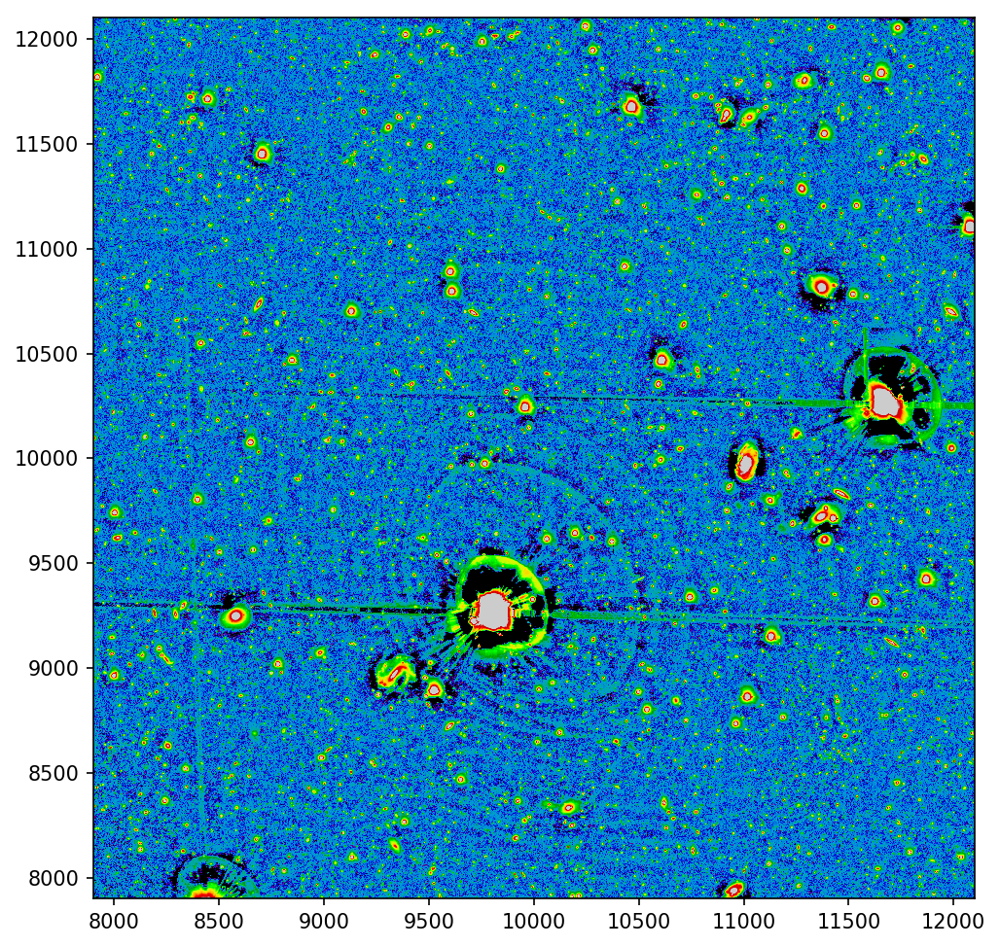

In [65]:
# postcal
%matplotlib inline
fig = plt.figure(figsize=(8,8), dpi=150, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
img, lo, hi = imprep(np.flip(calexpbg.image.array, 0), scale=99.99, fwhm=3, lo=-0.01, hi=2)
extent = (calexpbg.image.getBBox().getBeginX(), calexpbg.image.getBBox().getEndX(), 
          calexpbg.image.getBBox().getBeginY(), calexpbg.image.getBBox().getEndY())
plt.imshow(img, extent=extent, cmap="nipy_spectral")
plt.show()

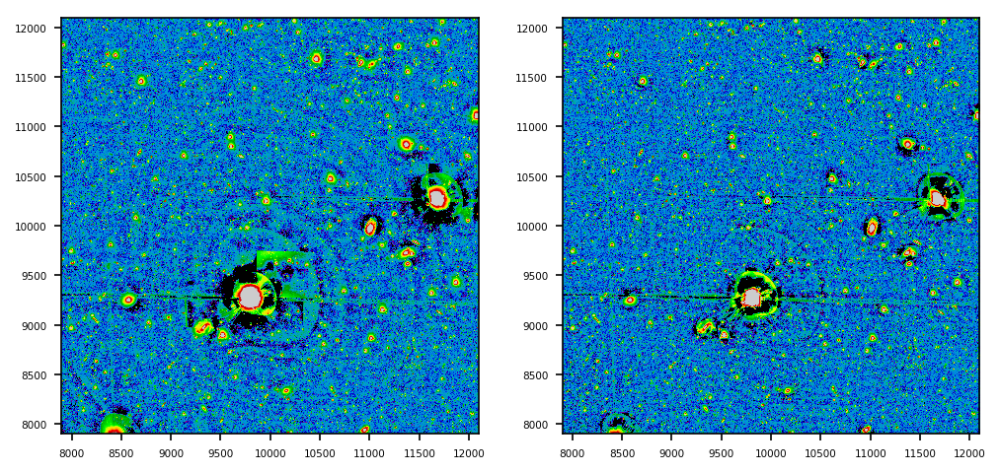

In [66]:
# postcal DEFAULT 512 vs 64
%matplotlib inline
extent = (calexp.image.getBBox().getBeginX(), calexp.image.getBBox().getEndX(), 
          calexp.image.getBBox().getBeginY(), calexp.image.getBBox().getEndY())
fig = plt.figure(figsize=(8,8), dpi=150, facecolor='w', edgecolor='k')
ax1 = fig.add_subplot(121)
img1, lo, hi = imprep(np.flip(calexp.image.array, 0), scale=99.99, fwhm=3, lo=-0.01, hi=2)
ax1.imshow(img1, extent=extent, cmap="nipy_spectral")
ax1.tick_params(axis='both', which='major', labelsize=5)
ax2 = fig.add_subplot(122)
img2, lo, hi = imprep(np.flip(calexpbg.image.array, 0), scale=99.99, fwhm=3, lo=-0.01, hi=2)
ax2.imshow(img2, extent=extent, cmap="nipy_spectral")
ax2.tick_params(axis='both', which='major', labelsize=5)
plt.show()

# More Data

Using multiBandDriver to run all patches from tract 9813 through the stack. Command: 

`multiBandDriver.py /datasets/hsc/repo --rerun RC/w_2019_38/DM-21386:private/lskelvin/apertures_fulldriver --batch-type=slurm --mpiexec='-bind-to socket' --job nrfcoadd --walltime 21600 --cores 24 --id tract=9813 filter=HSC-R -c measureCoaddSources.measurement.doReplaceWithNoise=False --configfile /project/lskelvin/apertures/config_driver.py`

or, for a single core run on the head node of a single patch:

`multiBandDriver.py /datasets/hsc/repo --rerun RC/w_2019_38/DM-21386:private/lskelvin/apertures_singledriver --batch-type=none --mpiexec='-bind-to socket' --job nrfcoadd --walltime 21600 --cores 1 --id tract=9813 filter=HSC-R patch=2,2 -c measureCoaddSources.measurement.doReplaceWithNoise=False --configfile /project/lskelvin/apertures/config_driver.py`

A slightly modified config file is also required, thus:

`config.measureCoaddSources.measurement.plugins['base_CircularApertureFlux'].radii=[3.0, 4.5, 6.0, 9.0, 12.0, 17.0, 25.0, 35.0, 50.0, 70.0, 250.0, 500.0]`<br>
`config.measurement.plugins.names -= ["modelfit_CModel"]`

Progress of jobs submitted to slurm can be checked using `squeue`.

# New Data?

In [67]:
# setup new rerun data ID, butler and table
dataid2 = {'tract': 9813, 'filter': 'HSC-R'}
butler2 = dafPersist.Butler("/datasets/hsc/repo/rerun/private/lskelvin/apertures_fulldriver")
xpatch = ypatch = np.arange(0,9,1)
xypatch = np.meshgrid(xpatch,ypatch)
allpatch = []
for i in range(9):
    for j in range(9):
        allpatch.append(str(xypatch[0][i,j])+','+str(xypatch[1][i,j]))
r500flux2 = np.array([])
r500fluxperpixel2 = np.array([])
r500flag2 = np.array([])
r250flux2 = np.array([])
r250fluxperpixel2 = np.array([])
r250flag2 = np.array([])
r9flux2 = np.array([])
r9fluxperpixel2 = np.array([])
r9flag2 = np.array([])
dataids2 = np.array([])
x2 = np.array([])
y2 = np.array([])
objid2 = np.array([])
import copy
for pat in allpatch:
    dataid2.update(patch=pat)
    try:
        r500flux2t, r500fluxperpixel2t, r500flag2t, x2t, y2t = getradflux(butler2, dataid2, 500)
        r250flux2t, r250fluxperpixel2t, r250flag2t, x2t, y2t = getradflux(butler2, dataid2, 250)
        r9flux2t, r9fluxperpixel2t, r9flag2t, x2t, y2t = getradflux(butler2, dataid2, 9)
        r500flux2 = np.append(r500flux2, r500flux2t)
        r500fluxperpixel2 = np.append(r500fluxperpixel2, r500fluxperpixel2t)
        r500flag2 = np.append(r500flag2, r500flag2t)
        r250flux2 = np.append(r250flux2, r250flux2t)
        r250fluxperpixel2 = np.append(r250fluxperpixel2, r250fluxperpixel2t)
        r250flag2 = np.append(r250flag2, r250flag2t)
        r9flux2 = np.append(r9flux2, r9flux2t)
        r9fluxperpixel2 = np.append(r9fluxperpixel2, r9fluxperpixel2t)
        r9flag2 = np.append(r9flag2, r9flag2t)
        dataid2n = copy.deepcopy(dataid2)
        dataids2t = np.repeat(dataid2n, len(r9flux2t))
        dataids2 = np.append(dataids2, dataids2t)
        x2 = np.append(x2, x2t)
        y2 = np.append(y2, y2t)
        objidA = np.repeat(int(pat.replace(",","")), len(x2t))
        objidB = [str(el).zfill(3) for el in np.arange(len(x2t))]
        objidt = [int(str(i) + str(j)) for i, j in zip(objidA, objidB)]
        objid2 = np.append(objid2, objidt)
    except:
        continue
r9mag2 = -2.5 * np.log10(r9flux2) + magzp
r250mag2 = -2.5 * np.log10(r250flux2) + magzp
r500mag2 = -2.5 * np.log10(r500flux2) + magzp

In [68]:
# binned median
from astropy.stats import sigma_clip as sc
old = np.seterr(invalid='ignore')
xx = r250mag2
yy = r9fluxperpixel2
ii = objid2
oo = xx.argsort()
xxx = xx[oo]
yyy = yy[oo]
iii = ii[oo]
bad = (np.isnan(xxx)) | (np.abs(yyy) > 0.05) # clip NaNs and extreme outliers
if sum(bad) > 0:
    xxx = xxx[~bad]
    yyy = yyy[~bad]
    iii = iii[~bad]
xrunmed = np.array([])
yrunmed = np.array([])
yrunsiglo = np.array([])
yrunsighi = np.array([])
# # equal bin number count method
# bidedges = np.linspace(0, len(xxx), 50)
# for first,last in zip(bidedges[:-1],bidedges[1:]):
#     warnings.simplefilter("ignore", category=RuntimeWarning)
#     ids = np.arange(int(first),int(last),1)
#     dat = sc(yyy[ids], sigma=3, masked=False)
#     xrunmed = np.append(xrunmed, np.nanmedian(xxx[ids]))
#     yrunmed = np.append(yrunmed, np.nanmedian(dat))
#     yrunsiglo = np.append(yrunsiglo, np.percentile(dat, 25))
#     yrunsighi = np.append(yrunsighi, np.percentile(dat, 75))
# equal bin width method
# bnumedges = np.linspace(np.min(xxx), np.max(xxx), num=10)
bnumedges = np.arange(13.5, 20.5, 1)
for start,end in zip(bnumedges[:-1],bnumedges[1:]):
    warnings.simplefilter("ignore", category=RuntimeWarning)    
    ids = np.where((xxx >= start) & (xxx <= end))
    dat = sc(yyy[ids], sigma=3, masked=False)
    xrunmed = np.append(xrunmed, np.nanmedian([start,end]))
    yrunmed = np.append(yrunmed, np.nanmedian(dat))
    yrunsiglo = np.append(yrunsiglo, np.percentile(dat, 15.86553))
    yrunsighi = np.append(yrunsighi, np.percentile(dat, 84.13447))    
objid2 = objid2.astype(int)

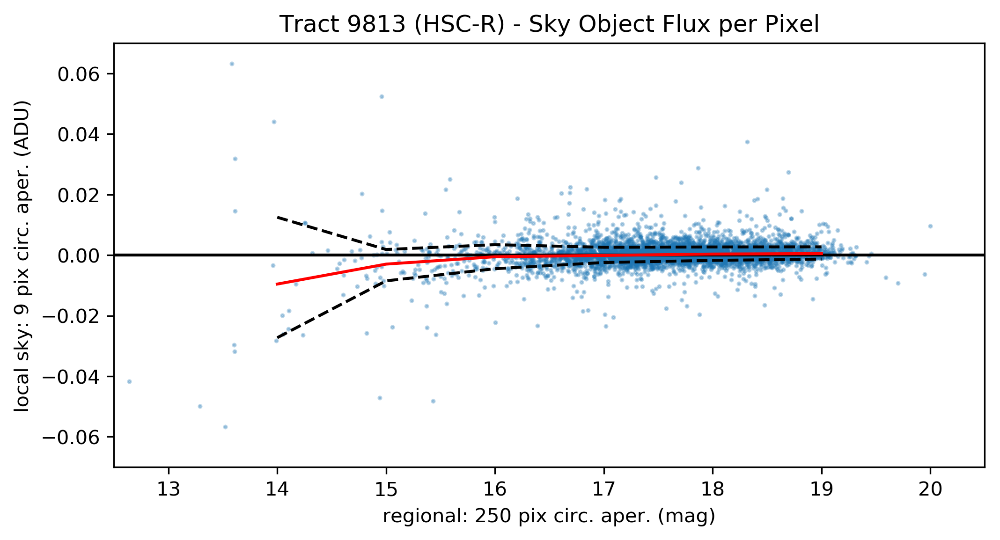

In [69]:
# 250 pixel vs. 9 pixel plot
%matplotlib inline
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(r250mag2, r9fluxperpixel2, alpha=0.3, s=2)
# for i, txt in enumerate(objid2):
#     ax.annotate(txt, (r250fluxperpixel2[i], r9fluxperpixel2[i]), clip_on=True, fontsize=4)
plt.axhline(y=0, c='k')
ax.set_xlim(12.5,20.5)
ax.set_ylim(-0.07,0.07)
# ax.set_xscale('log')
plt.xlabel('regional: 250 pix circ. aper. (mag)')
plt.ylabel('local sky: 9 pix circ. aper. (ADU)')
plt.title('Tract ' + str(dataid2['tract']) + ' (' + str(dataid2['filter']) + ') - Sky Object Flux per Pixel')
plt.plot(xrunmed, yrunmed, c='r')
plt.plot(xrunmed, yrunsiglo, c='k', ls='--')
plt.plot(xrunmed, yrunsighi, c='k', ls='--')
# xfit = np.linspace(12.5,20.5,100)
# yfit = np.poly1d(np.polyfit(xxx-20, yyy, deg=10))(xfit-20)
# plt.plot(xfit,yfit, c='darkred', lw=2, ls='dotted')
plt.show()

In [70]:
# approximate error on the sky
good = np.where((xrunmed >= 18) & (xrunmed <= 19))
skyerr = np.median(np.append(np.abs(yrunsiglo[good]), np.abs(yrunsighi[good])))
print(skyerr)

0.0022161843458913663


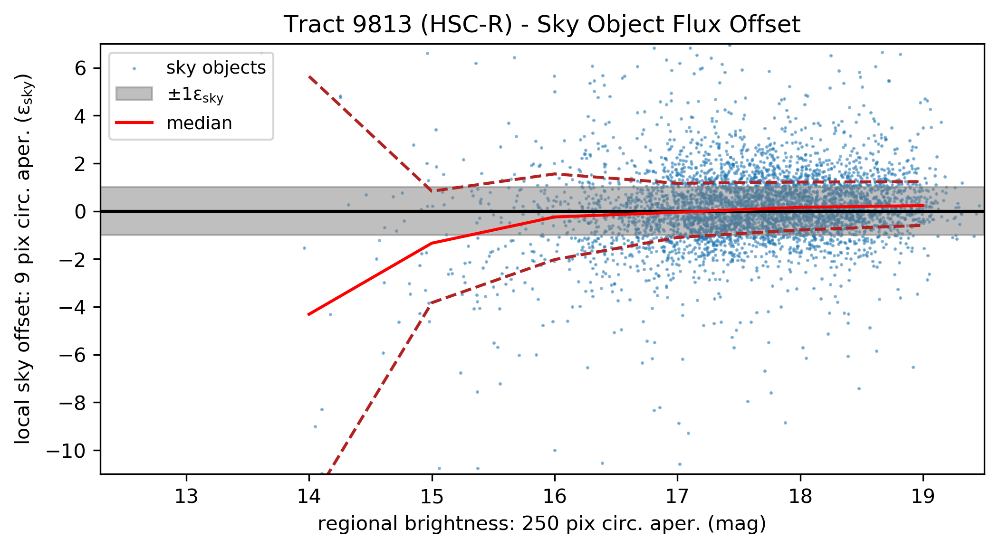

In [71]:
# 250 pixel vs. 9 pixel plot
%matplotlib inline
xlo = 12.3
xhi = 19.5
fig = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax = fig.add_subplot(111)
ax.scatter(r250mag2, r9fluxperpixel2/skyerr, alpha=0.5, s=0.5, label="sky objects")
# for i, txt in enumerate(objid2):
#     ax.annotate(txt, (r250mag2[i], r9fluxperpixel2[i]/skyerr), clip_on=True, fontsize=4)
plt.axhline(y=0, c='k')
ax.fill_between([xlo,xhi], [1,1], [-1,-1], color='grey', alpha=0.5, label="$\pm1\mathregular{\epsilon_{sky}}$")
ax.set_xlim(xlo,xhi)
ax.set_ylim(-11,7)
# ax.set_xscale('log')
plt.xlabel('regional brightness: 250 pix circ. aper. (mag)')
plt.ylabel('local sky offset: 9 pix circ. aper. ($\mathregular{\epsilon_{sky}}$)')
plt.title('Tract ' + str(dataid2['tract']) + ' (' + str(dataid2['filter']) + ') - Sky Object Flux Offset')
plt.plot(xrunmed, yrunmed/skyerr, c='r', label='median')
plt.plot(xrunmed, yrunsiglo/skyerr, c='firebrick', ls='--')
plt.plot(xrunmed, yrunsighi/skyerr, c='firebrick', ls='--')
# xfit = np.linspace(4e-3,2e0)
# yfit = 0.0007 - 0.01*xfit**0.8
# plt.plot(xfit,yfit/skyerr, c='darkred', lw=2, ls='dotted')
handles, labels = ax.get_legend_handles_labels()
handles = [handles[1], handles[2], handles[0]]
labels = [labels[1], labels[2], labels[0]]
ax.legend(handles, labels, loc='upper left', fontsize=9)
plt.show()

In [72]:
good = np.where((r250mag2>14.9) & (r250mag2<15.1) & 
                ((r9fluxperpixel2/skyerr)>-1.8) & ((r9fluxperpixel2/skyerr)<-1.6))
objid2[good]

array([42044, 33054])

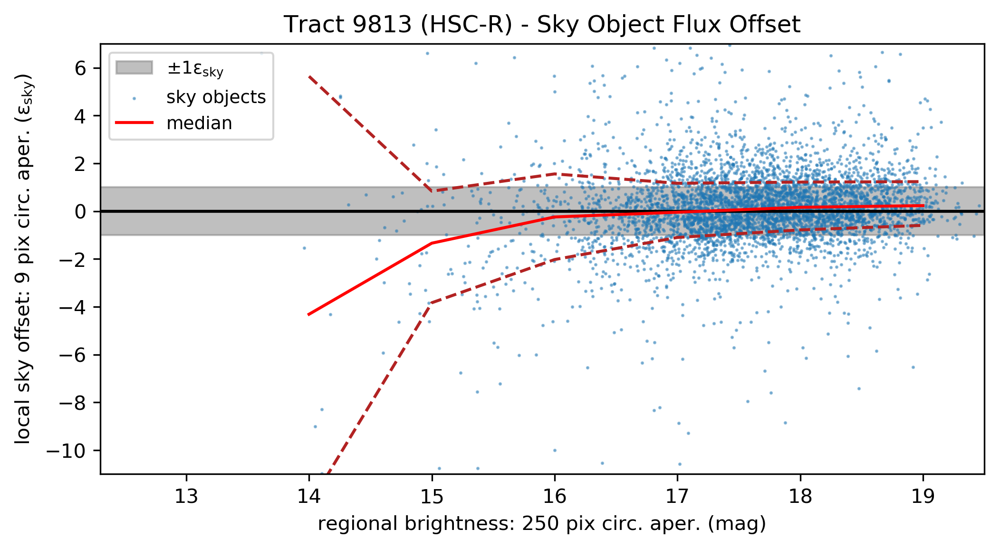

STATISTICS: OBJECT 22045
local sky: ADU: -14.4 , ADU/pixel: -0.057 , εₛ: -25.6
regional: ADU: 245744.5 , ADU/pixel: 1.252 , mag: 13.5


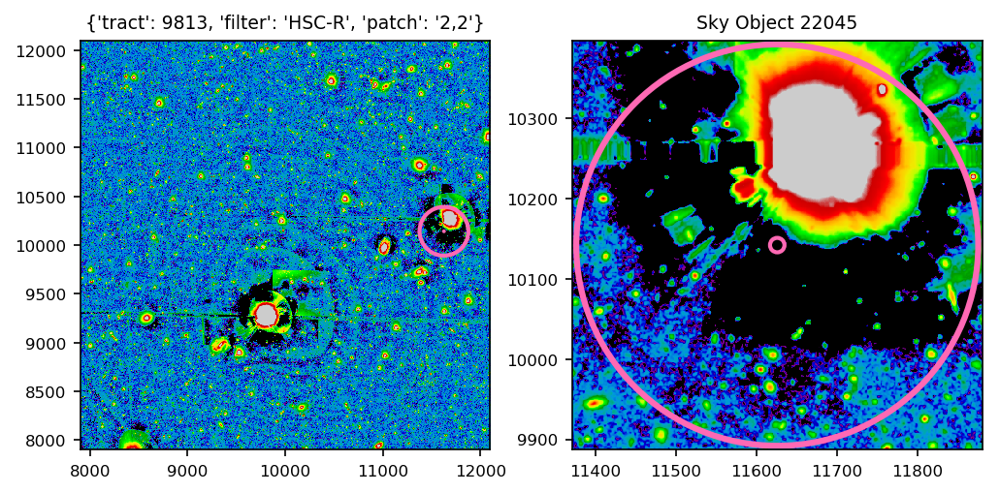

In [73]:
%matplotlib inline
oid = 22045
xlo = 12.3
xhi = 19.5
cid = int(np.where(objid2 == oid)[0])
# scatter plot
fig1 = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax1 = fig1.add_subplot(111)
ax1.fill_between([xlo,xhi], [1,1], [-1,-1], color='grey', alpha=0.5, label="$\pm1\mathregular{\epsilon_{sky}}$")
ax1.scatter(r250mag2, r9fluxperpixel2/skyerr, alpha=0.5, s=0.5, label="sky objects")
plt.axhline(y=0, c='k')
ax1.set_xlim(xlo,xhi)
ax1.set_ylim(-11,7)
plt.xlabel('regional brightness: 250 pix circ. aper. (mag)')
plt.ylabel('local sky offset: 9 pix circ. aper. ($\mathregular{\epsilon_{sky}}$)')
plt.title('Tract ' + str(dataid2['tract']) + ' (' + str(dataid2['filter']) + ') - Sky Object Flux Offset')
plt.plot(xrunmed, yrunmed/skyerr, c='r', label='median')
plt.plot(xrunmed, yrunsiglo/skyerr, c='firebrick', ls='--')
plt.plot(xrunmed, yrunsighi/skyerr, c='firebrick', ls='--')
handles, labels = ax1.get_legend_handles_labels()
handles = [handles[1], handles[2], handles[0]]
labels = [labels[1], labels[2], labels[0]]
ax1.legend(handles, labels, loc='upper left', fontsize=9)
ax1.scatter(r250mag2[cid], r9fluxperpixel2[cid]/skyerr)
ax1.annotate(str(oid), (r250mag2[cid], r9fluxperpixel2[cid]/skyerr), clip_on=True, fontsize=9, va='top')
plt.show()
# statistics
print('STATISTICS: OBJECT', oid)
print('local sky:', 
      'ADU:', np.round(r9flux2[cid],1), 
      ', ADU/pixel:', np.round(r9fluxperpixel2[cid],3), 
      ', εₛ:', np.round(r9fluxperpixel2[cid]/skyerr,1)
     )
print('regional:', 
      'ADU:', np.round(r250flux2[cid],1), 
      ', ADU/pixel:', np.round(r250fluxperpixel2[cid],3),
      ', mag:', np.round(r250mag2[cid],1)
     )
# butler get image
calexp2 = butler2.get('deepCoadd_calexp', dataId=dataids2[cid])
extent = (calexp2.image.getBBox().getBeginX(), calexp2.image.getBBox().getEndX(), 
          calexp2.image.getBBox().getBeginY(), calexp2.image.getBBox().getEndY())
# full image
fig2 = plt.figure(figsize=(8,4), dpi=150, facecolor='w', edgecolor='k')
ax2 = fig2.add_subplot(121)
ax2.tick_params(axis='both', which='major', labelsize=8)
img2, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img2, extent=extent, cmap="nipy_spectral")
medcircles2 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=2)
smallcircles2 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink')
plt.gcf().gca().add_artist(medcircles2)
plt.gcf().gca().add_artist(smallcircles2)
plt.title(str(dataids2[cid]), fontsize=9)
# zoom image
ax3 = fig2.add_subplot(122)
ax3.tick_params(axis='both', which='major', labelsize=8)
img3, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img3, extent=extent, cmap="nipy_spectral")
medcircles3 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=3)
smallcircles3 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink', linewidth=2)
plt.gcf().gca().add_artist(medcircles3)
plt.gcf().gca().add_artist(smallcircles3)
zoom = 255
plt.xlim(x2[cid]-zoom,x2[cid]+zoom)
plt.ylim(y2[cid]-zoom,y2[cid]+zoom)
plt.title('Sky Object '+ str(oid), fontsize=9)
plt.show()

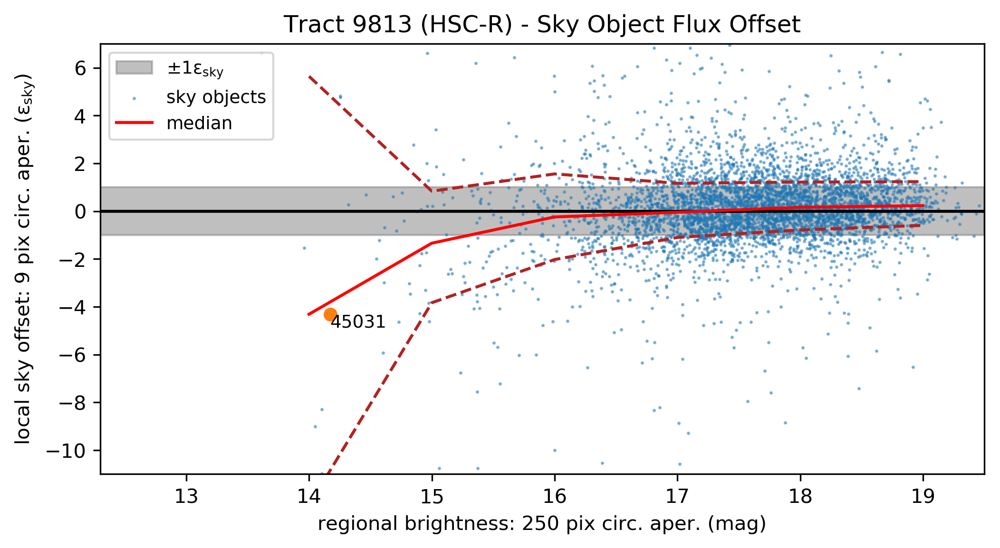

STATISTICS: OBJECT 45031
local sky: ADU: -2.4 , ADU/pixel: -0.01 , εₛ: -4.3
regional: ADU: 135268.7 , ADU/pixel: 0.689 , mag: 14.2


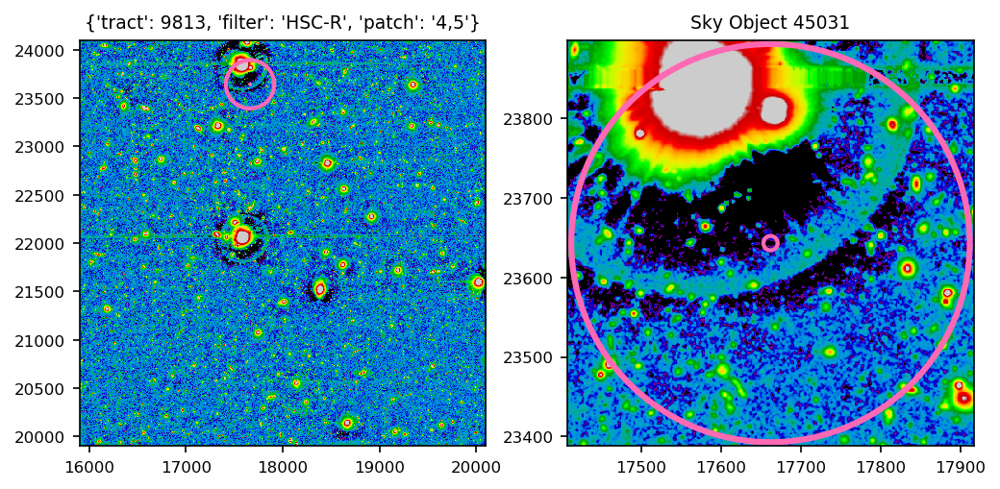

In [74]:
%matplotlib inline
oid = 45031
xlo = 12.3
xhi = 19.5
cid = int(np.where(objid2 == oid)[0])
# scatter plot
fig1 = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax1 = fig1.add_subplot(111)
ax1.fill_between([xlo,xhi], [1,1], [-1,-1], color='grey', alpha=0.5, label="$\pm1\mathregular{\epsilon_{sky}}$")
ax1.scatter(r250mag2, r9fluxperpixel2/skyerr, alpha=0.5, s=0.5, label="sky objects")
plt.axhline(y=0, c='k')
ax1.set_xlim(xlo,xhi)
ax1.set_ylim(-11,7)
plt.xlabel('regional brightness: 250 pix circ. aper. (mag)')
plt.ylabel('local sky offset: 9 pix circ. aper. ($\mathregular{\epsilon_{sky}}$)')
plt.title('Tract ' + str(dataid2['tract']) + ' (' + str(dataid2['filter']) + ') - Sky Object Flux Offset')
plt.plot(xrunmed, yrunmed/skyerr, c='r', label='median')
plt.plot(xrunmed, yrunsiglo/skyerr, c='firebrick', ls='--')
plt.plot(xrunmed, yrunsighi/skyerr, c='firebrick', ls='--')
handles, labels = ax1.get_legend_handles_labels()
handles = [handles[1], handles[2], handles[0]]
labels = [labels[1], labels[2], labels[0]]
ax1.legend(handles, labels, loc='upper left', fontsize=9)
ax1.scatter(r250mag2[cid], r9fluxperpixel2[cid]/skyerr)
ax1.annotate(str(oid), (r250mag2[cid], r9fluxperpixel2[cid]/skyerr), clip_on=True, fontsize=9, va='top')
plt.show()
# statistics
print('STATISTICS: OBJECT', oid)
print('local sky:', 
      'ADU:', np.round(r9flux2[cid],1), 
      ', ADU/pixel:', np.round(r9fluxperpixel2[cid],3), 
      ', εₛ:', np.round(r9fluxperpixel2[cid]/skyerr,1)
     )
print('regional:', 
      'ADU:', np.round(r250flux2[cid],1), 
      ', ADU/pixel:', np.round(r250fluxperpixel2[cid],3),
      ', mag:', np.round(r250mag2[cid],1)
     )
# butler get image
calexp2 = butler2.get('deepCoadd_calexp', dataId=dataids2[cid])
extent = (calexp2.image.getBBox().getBeginX(), calexp2.image.getBBox().getEndX(), 
          calexp2.image.getBBox().getBeginY(), calexp2.image.getBBox().getEndY())
# full image
fig2 = plt.figure(figsize=(8,4), dpi=150, facecolor='w', edgecolor='k')
ax2 = fig2.add_subplot(121)
ax2.tick_params(axis='both', which='major', labelsize=8)
img2, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img2, extent=extent, cmap="nipy_spectral")
medcircles2 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=2)
smallcircles2 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink')
plt.gcf().gca().add_artist(medcircles2)
plt.gcf().gca().add_artist(smallcircles2)
plt.title(str(dataids2[cid]), fontsize=9)
# zoom image
ax3 = fig2.add_subplot(122)
ax3.tick_params(axis='both', which='major', labelsize=8)
img3, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img3, extent=extent, cmap="nipy_spectral")
medcircles3 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=3)
smallcircles3 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink', linewidth=2)
plt.gcf().gca().add_artist(medcircles3)
plt.gcf().gca().add_artist(smallcircles3)
zoom = 255
plt.xlim(x2[cid]-zoom,x2[cid]+zoom)
plt.ylim(y2[cid]-zoom,y2[cid]+zoom)
plt.title('Sky Object '+ str(oid), fontsize=9)
plt.show()

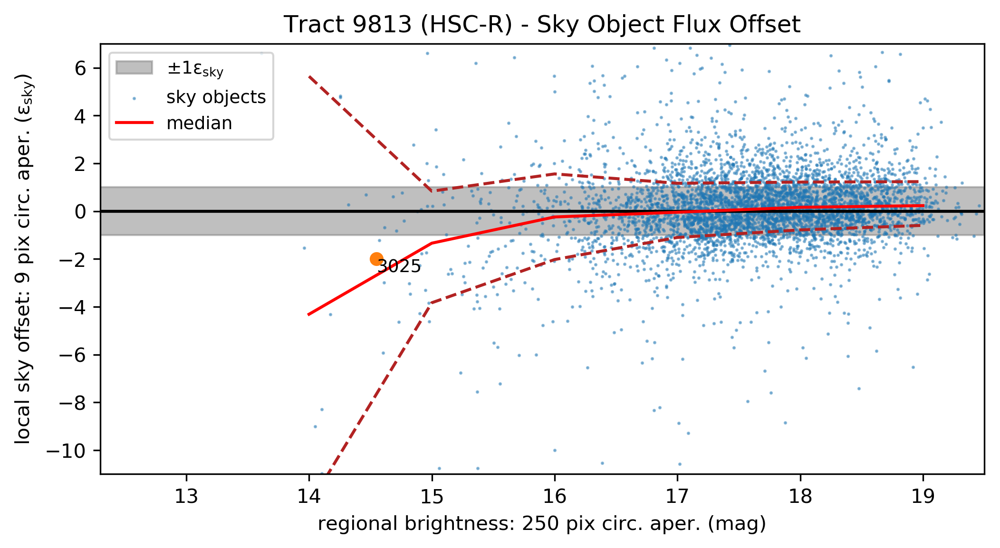

STATISTICS: OBJECT 3025
local sky: ADU: -1.1 , ADU/pixel: -0.004 , εₛ: -2.0
regional: ADU: 95481.5 , ADU/pixel: 0.486 , mag: 14.6


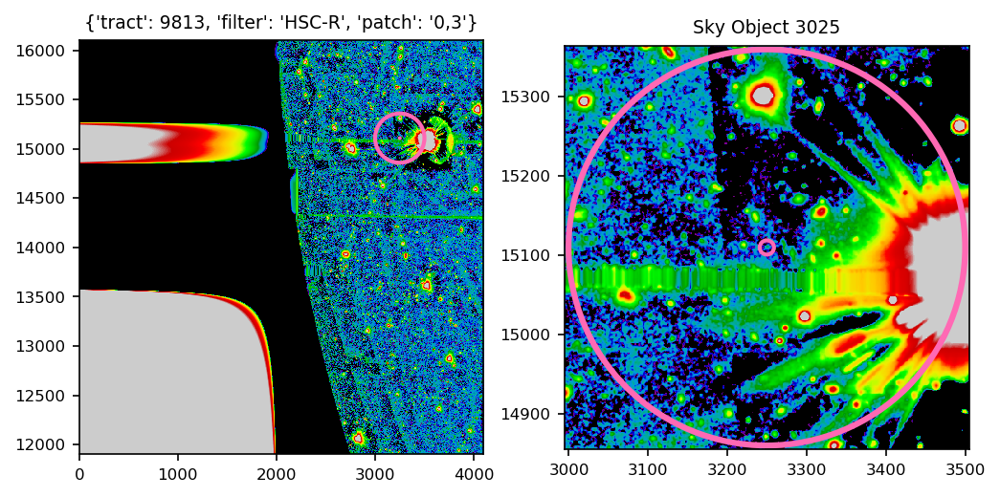

In [75]:
%matplotlib inline
oid = 3025
xlo = 12.3
xhi = 19.5
cid = int(np.where(objid2 == oid)[0])
# scatter plot
fig1 = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax1 = fig1.add_subplot(111)
ax1.fill_between([xlo,xhi], [1,1], [-1,-1], color='grey', alpha=0.5, label="$\pm1\mathregular{\epsilon_{sky}}$")
ax1.scatter(r250mag2, r9fluxperpixel2/skyerr, alpha=0.5, s=0.5, label="sky objects")
plt.axhline(y=0, c='k')
ax1.set_xlim(xlo,xhi)
ax1.set_ylim(-11,7)
plt.xlabel('regional brightness: 250 pix circ. aper. (mag)')
plt.ylabel('local sky offset: 9 pix circ. aper. ($\mathregular{\epsilon_{sky}}$)')
plt.title('Tract ' + str(dataid2['tract']) + ' (' + str(dataid2['filter']) + ') - Sky Object Flux Offset')
plt.plot(xrunmed, yrunmed/skyerr, c='r', label='median')
plt.plot(xrunmed, yrunsiglo/skyerr, c='firebrick', ls='--')
plt.plot(xrunmed, yrunsighi/skyerr, c='firebrick', ls='--')
handles, labels = ax1.get_legend_handles_labels()
handles = [handles[1], handles[2], handles[0]]
labels = [labels[1], labels[2], labels[0]]
ax1.legend(handles, labels, loc='upper left', fontsize=9)
ax1.scatter(r250mag2[cid], r9fluxperpixel2[cid]/skyerr)
ax1.annotate(str(oid), (r250mag2[cid], r9fluxperpixel2[cid]/skyerr), clip_on=True, fontsize=9, va='top')
plt.show()
# statistics
print('STATISTICS: OBJECT', oid)
print('local sky:', 
      'ADU:', np.round(r9flux2[cid],1), 
      ', ADU/pixel:', np.round(r9fluxperpixel2[cid],3), 
      ', εₛ:', np.round(r9fluxperpixel2[cid]/skyerr,1)
     )
print('regional:', 
      'ADU:', np.round(r250flux2[cid],1), 
      ', ADU/pixel:', np.round(r250fluxperpixel2[cid],3),
      ', mag:', np.round(r250mag2[cid],1)
     )
# butler get image
calexp2 = butler2.get('deepCoadd_calexp', dataId=dataids2[cid])
extent = (calexp2.image.getBBox().getBeginX(), calexp2.image.getBBox().getEndX(), 
          calexp2.image.getBBox().getBeginY(), calexp2.image.getBBox().getEndY())
# full image
fig2 = plt.figure(figsize=(8,4), dpi=150, facecolor='w', edgecolor='k')
ax2 = fig2.add_subplot(121)
ax2.tick_params(axis='both', which='major', labelsize=8)
img2, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img2, extent=extent, cmap="nipy_spectral")
medcircles2 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=2)
smallcircles2 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink')
plt.gcf().gca().add_artist(medcircles2)
plt.gcf().gca().add_artist(smallcircles2)
plt.title(str(dataids2[cid]), fontsize=9)
# zoom image
ax3 = fig2.add_subplot(122)
ax3.tick_params(axis='both', which='major', labelsize=8)
img3, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img3, extent=extent, cmap="nipy_spectral")
medcircles3 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=3)
smallcircles3 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink', linewidth=2)
plt.gcf().gca().add_artist(medcircles3)
plt.gcf().gca().add_artist(smallcircles3)
zoom = 255
plt.xlim(x2[cid]-zoom,x2[cid]+zoom)
plt.ylim(y2[cid]-zoom,y2[cid]+zoom)
plt.title('Sky Object '+ str(oid), fontsize=9)
plt.show()

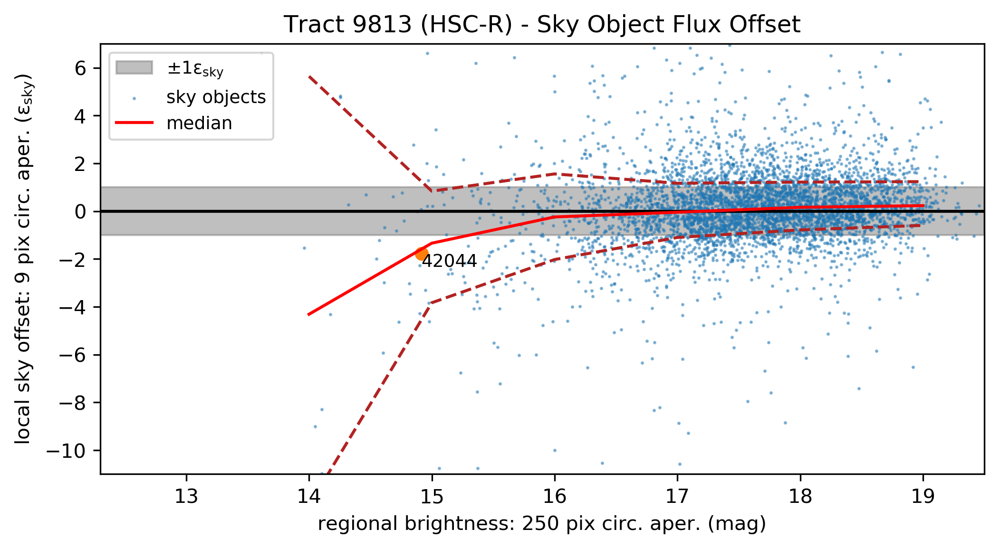

STATISTICS: OBJECT 42044
local sky: ADU: -1.0 , ADU/pixel: -0.004 , εₛ: -1.8
regional: ADU: 68209.0 , ADU/pixel: 0.347 , mag: 14.9


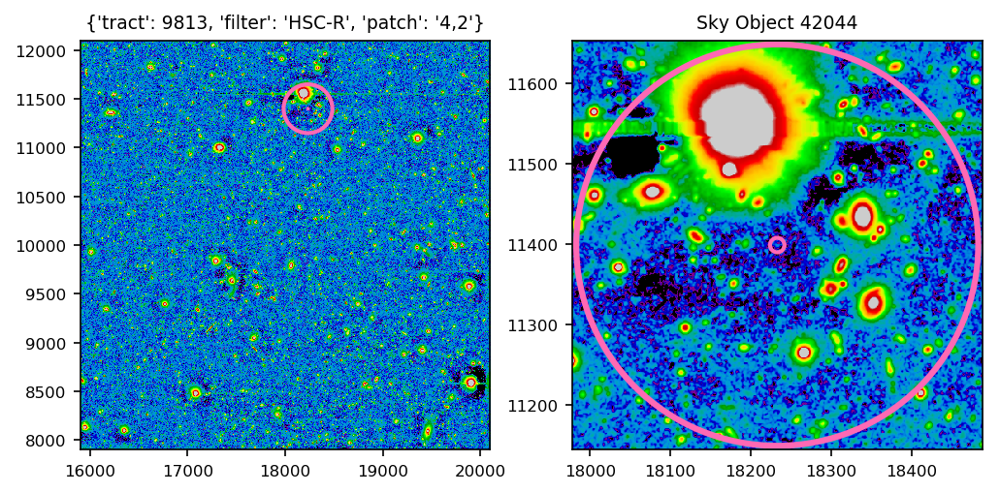

In [76]:
%matplotlib inline
oid = 42044
xlo = 12.3
xhi = 19.5
cid = int(np.where(objid2 == oid)[0])
# scatter plot
fig1 = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax1 = fig1.add_subplot(111)
ax1.fill_between([xlo,xhi], [1,1], [-1,-1], color='grey', alpha=0.5, label="$\pm1\mathregular{\epsilon_{sky}}$")
ax1.scatter(r250mag2, r9fluxperpixel2/skyerr, alpha=0.5, s=0.5, label="sky objects")
plt.axhline(y=0, c='k')
ax1.set_xlim(xlo,xhi)
ax1.set_ylim(-11,7)
plt.xlabel('regional brightness: 250 pix circ. aper. (mag)')
plt.ylabel('local sky offset: 9 pix circ. aper. ($\mathregular{\epsilon_{sky}}$)')
plt.title('Tract ' + str(dataid2['tract']) + ' (' + str(dataid2['filter']) + ') - Sky Object Flux Offset')
plt.plot(xrunmed, yrunmed/skyerr, c='r', label='median')
plt.plot(xrunmed, yrunsiglo/skyerr, c='firebrick', ls='--')
plt.plot(xrunmed, yrunsighi/skyerr, c='firebrick', ls='--')
handles, labels = ax1.get_legend_handles_labels()
handles = [handles[1], handles[2], handles[0]]
labels = [labels[1], labels[2], labels[0]]
ax1.legend(handles, labels, loc='upper left', fontsize=9)
ax1.scatter(r250mag2[cid], r9fluxperpixel2[cid]/skyerr)
ax1.annotate(str(oid), (r250mag2[cid], r9fluxperpixel2[cid]/skyerr), clip_on=True, fontsize=9, va='top')
plt.show()
# statistics
print('STATISTICS: OBJECT', oid)
print('local sky:', 
      'ADU:', np.round(r9flux2[cid],1), 
      ', ADU/pixel:', np.round(r9fluxperpixel2[cid],3), 
      ', εₛ:', np.round(r9fluxperpixel2[cid]/skyerr,1)
     )
print('regional:', 
      'ADU:', np.round(r250flux2[cid],1), 
      ', ADU/pixel:', np.round(r250fluxperpixel2[cid],3),
      ', mag:', np.round(r250mag2[cid],1)
     )
# butler get image
calexp2 = butler2.get('deepCoadd_calexp', dataId=dataids2[cid])
extent = (calexp2.image.getBBox().getBeginX(), calexp2.image.getBBox().getEndX(), 
          calexp2.image.getBBox().getBeginY(), calexp2.image.getBBox().getEndY())
# full image
fig2 = plt.figure(figsize=(8,4), dpi=150, facecolor='w', edgecolor='k')
ax2 = fig2.add_subplot(121)
ax2.tick_params(axis='both', which='major', labelsize=8)
img2, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img2, extent=extent, cmap="nipy_spectral")
medcircles2 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=2)
smallcircles2 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink')
plt.gcf().gca().add_artist(medcircles2)
plt.gcf().gca().add_artist(smallcircles2)
plt.title(str(dataids2[cid]), fontsize=9)
# zoom image
ax3 = fig2.add_subplot(122)
ax3.tick_params(axis='both', which='major', labelsize=8)
img3, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img3, extent=extent, cmap="nipy_spectral")
medcircles3 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=3)
smallcircles3 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink', linewidth=2)
plt.gcf().gca().add_artist(medcircles3)
plt.gcf().gca().add_artist(smallcircles3)
zoom = 255
plt.xlim(x2[cid]-zoom,x2[cid]+zoom)
plt.ylim(y2[cid]-zoom,y2[cid]+zoom)
plt.title('Sky Object '+ str(oid), fontsize=9)
plt.show()

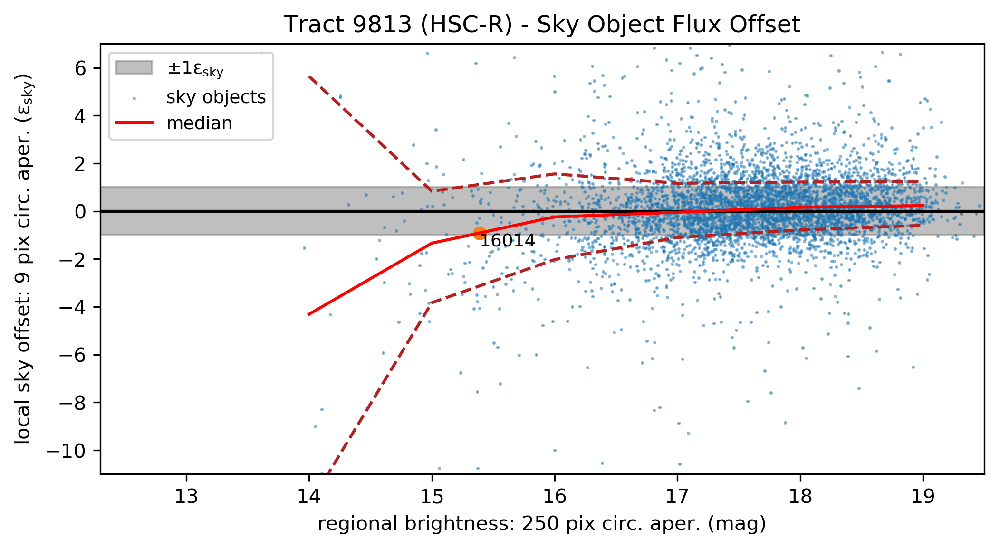

STATISTICS: OBJECT 16014
local sky: ADU: -0.5 , ADU/pixel: -0.002 , εₛ: -0.9
regional: ADU: 44089.9 , ADU/pixel: 0.225 , mag: 15.4


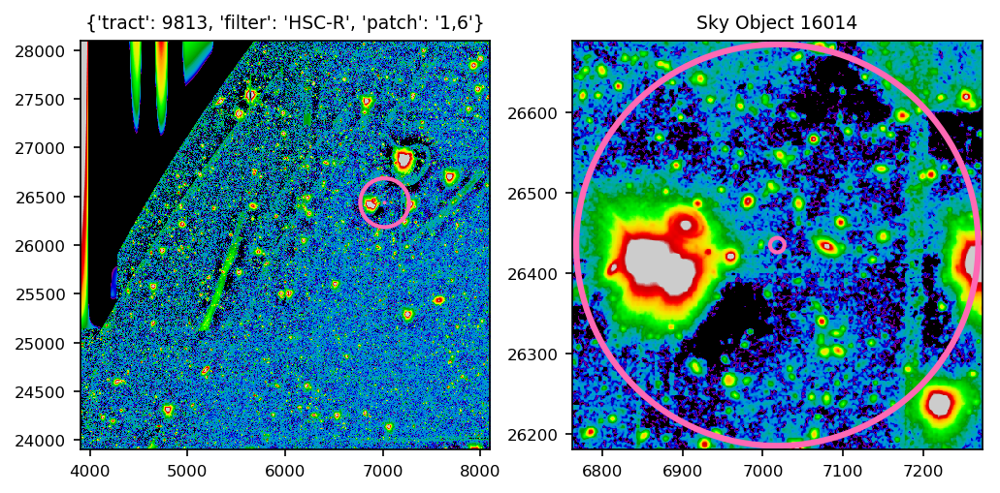

In [77]:
%matplotlib inline
oid = 16014
xlo = 12.3
xhi = 19.5
cid = int(np.where(objid2 == oid)[0])
# scatter plot
fig1 = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax1 = fig1.add_subplot(111)
ax1.fill_between([xlo,xhi], [1,1], [-1,-1], color='grey', alpha=0.5, label="$\pm1\mathregular{\epsilon_{sky}}$")
ax1.scatter(r250mag2, r9fluxperpixel2/skyerr, alpha=0.5, s=0.5, label="sky objects")
plt.axhline(y=0, c='k')
ax1.set_xlim(xlo,xhi)
ax1.set_ylim(-11,7)
plt.xlabel('regional brightness: 250 pix circ. aper. (mag)')
plt.ylabel('local sky offset: 9 pix circ. aper. ($\mathregular{\epsilon_{sky}}$)')
plt.title('Tract ' + str(dataid2['tract']) + ' (' + str(dataid2['filter']) + ') - Sky Object Flux Offset')
plt.plot(xrunmed, yrunmed/skyerr, c='r', label='median')
plt.plot(xrunmed, yrunsiglo/skyerr, c='firebrick', ls='--')
plt.plot(xrunmed, yrunsighi/skyerr, c='firebrick', ls='--')
handles, labels = ax1.get_legend_handles_labels()
handles = [handles[1], handles[2], handles[0]]
labels = [labels[1], labels[2], labels[0]]
ax1.legend(handles, labels, loc='upper left', fontsize=9)
ax1.scatter(r250mag2[cid], r9fluxperpixel2[cid]/skyerr)
ax1.annotate(str(oid), (r250mag2[cid], r9fluxperpixel2[cid]/skyerr), clip_on=True, fontsize=9, va='top')
plt.show()
# statistics
print('STATISTICS: OBJECT', oid)
print('local sky:', 
      'ADU:', np.round(r9flux2[cid],1), 
      ', ADU/pixel:', np.round(r9fluxperpixel2[cid],3), 
      ', εₛ:', np.round(r9fluxperpixel2[cid]/skyerr,1)
     )
print('regional:', 
      'ADU:', np.round(r250flux2[cid],1), 
      ', ADU/pixel:', np.round(r250fluxperpixel2[cid],3),
      ', mag:', np.round(r250mag2[cid],1)
     )
# butler get image
calexp2 = butler2.get('deepCoadd_calexp', dataId=dataids2[cid])
extent = (calexp2.image.getBBox().getBeginX(), calexp2.image.getBBox().getEndX(), 
          calexp2.image.getBBox().getBeginY(), calexp2.image.getBBox().getEndY())
# full image
fig2 = plt.figure(figsize=(8,4), dpi=150, facecolor='w', edgecolor='k')
ax2 = fig2.add_subplot(121)
ax2.tick_params(axis='both', which='major', labelsize=8)
img2, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img2, extent=extent, cmap="nipy_spectral")
medcircles2 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=2)
smallcircles2 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink')
plt.gcf().gca().add_artist(medcircles2)
plt.gcf().gca().add_artist(smallcircles2)
plt.title(str(dataids2[cid]), fontsize=9)
# zoom image
ax3 = fig2.add_subplot(122)
ax3.tick_params(axis='both', which='major', labelsize=8)
img3, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img3, extent=extent, cmap="nipy_spectral")
medcircles3 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=3)
smallcircles3 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink', linewidth=2)
plt.gcf().gca().add_artist(medcircles3)
plt.gcf().gca().add_artist(smallcircles3)
zoom = 255
plt.xlim(x2[cid]-zoom,x2[cid]+zoom)
plt.ylim(y2[cid]-zoom,y2[cid]+zoom)
plt.title('Sky Object '+ str(oid), fontsize=9)
plt.show()

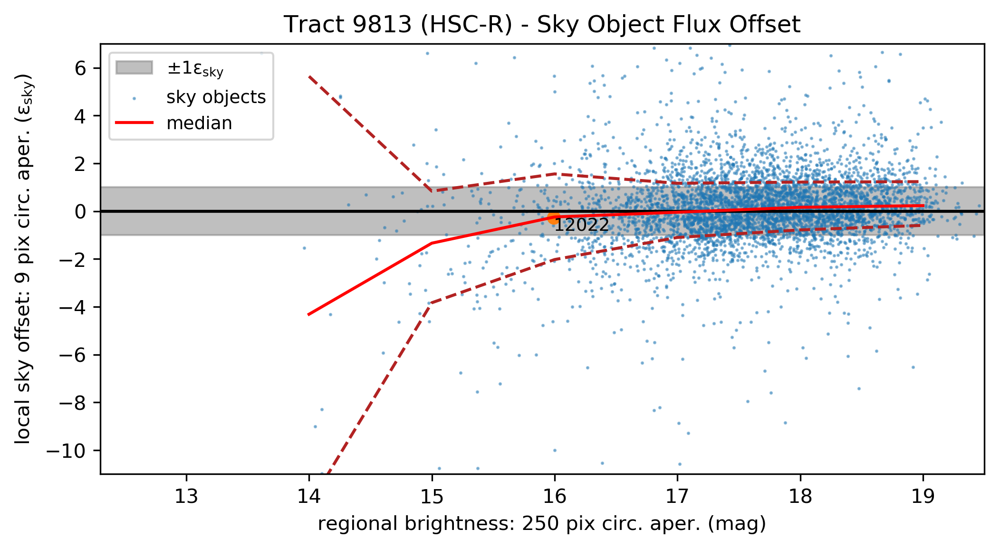

STATISTICS: OBJECT 12022
local sky: ADU: -0.2 , ADU/pixel: -0.001 , εₛ: -0.3
regional: ADU: 25324.9 , ADU/pixel: 0.129 , mag: 16.0


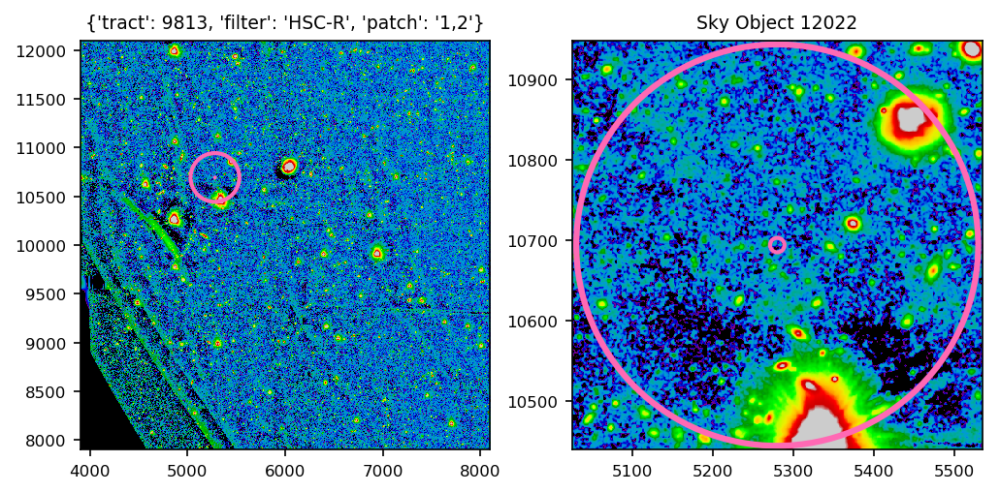

In [78]:
%matplotlib inline
oid = 12022
xlo = 12.3
xhi = 19.5
cid = int(np.where(objid2 == oid)[0])
# scatter plot
fig1 = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax1 = fig1.add_subplot(111)
ax1.fill_between([xlo,xhi], [1,1], [-1,-1], color='grey', alpha=0.5, label="$\pm1\mathregular{\epsilon_{sky}}$")
ax1.scatter(r250mag2, r9fluxperpixel2/skyerr, alpha=0.5, s=0.5, label="sky objects")
plt.axhline(y=0, c='k')
ax1.set_xlim(xlo,xhi)
ax1.set_ylim(-11,7)
plt.xlabel('regional brightness: 250 pix circ. aper. (mag)')
plt.ylabel('local sky offset: 9 pix circ. aper. ($\mathregular{\epsilon_{sky}}$)')
plt.title('Tract ' + str(dataid2['tract']) + ' (' + str(dataid2['filter']) + ') - Sky Object Flux Offset')
plt.plot(xrunmed, yrunmed/skyerr, c='r', label='median')
plt.plot(xrunmed, yrunsiglo/skyerr, c='firebrick', ls='--')
plt.plot(xrunmed, yrunsighi/skyerr, c='firebrick', ls='--')
handles, labels = ax1.get_legend_handles_labels()
handles = [handles[1], handles[2], handles[0]]
labels = [labels[1], labels[2], labels[0]]
ax1.legend(handles, labels, loc='upper left', fontsize=9)
ax1.scatter(r250mag2[cid], r9fluxperpixel2[cid]/skyerr)
ax1.annotate(str(oid), (r250mag2[cid], r9fluxperpixel2[cid]/skyerr), clip_on=True, fontsize=9, va='top')
plt.show()
# statistics
print('STATISTICS: OBJECT', oid)
print('local sky:', 
      'ADU:', np.round(r9flux2[cid],1), 
      ', ADU/pixel:', np.round(r9fluxperpixel2[cid],3), 
      ', εₛ:', np.round(r9fluxperpixel2[cid]/skyerr,1)
     )
print('regional:', 
      'ADU:', np.round(r250flux2[cid],1), 
      ', ADU/pixel:', np.round(r250fluxperpixel2[cid],3),
      ', mag:', np.round(r250mag2[cid],1)
     )
# butler get image
calexp2 = butler2.get('deepCoadd_calexp', dataId=dataids2[cid])
extent = (calexp2.image.getBBox().getBeginX(), calexp2.image.getBBox().getEndX(), 
          calexp2.image.getBBox().getBeginY(), calexp2.image.getBBox().getEndY())
# full image
fig2 = plt.figure(figsize=(8,4), dpi=150, facecolor='w', edgecolor='k')
ax2 = fig2.add_subplot(121)
ax2.tick_params(axis='both', which='major', labelsize=8)
img2, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img2, extent=extent, cmap="nipy_spectral")
medcircles2 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=2)
smallcircles2 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink')
plt.gcf().gca().add_artist(medcircles2)
plt.gcf().gca().add_artist(smallcircles2)
plt.title(str(dataids2[cid]), fontsize=9)
# zoom image
ax3 = fig2.add_subplot(122)
ax3.tick_params(axis='both', which='major', labelsize=8)
img3, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img3, extent=extent, cmap="nipy_spectral")
medcircles3 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=3)
smallcircles3 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink', linewidth=2)
plt.gcf().gca().add_artist(medcircles3)
plt.gcf().gca().add_artist(smallcircles3)
zoom = 255
plt.xlim(x2[cid]-zoom,x2[cid]+zoom)
plt.ylim(y2[cid]-zoom,y2[cid]+zoom)
plt.title('Sky Object '+ str(oid), fontsize=9)
plt.show()

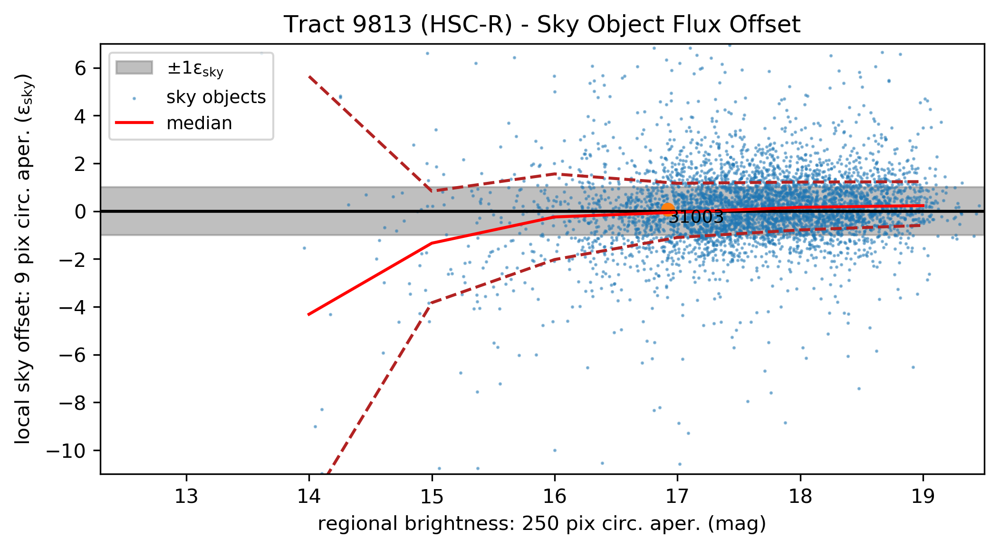

STATISTICS: OBJECT 31003
local sky: ADU: 0.0 , ADU/pixel: 0.0 , εₛ: 0.1
regional: ADU: 10747.2 , ADU/pixel: 0.055 , mag: 16.9


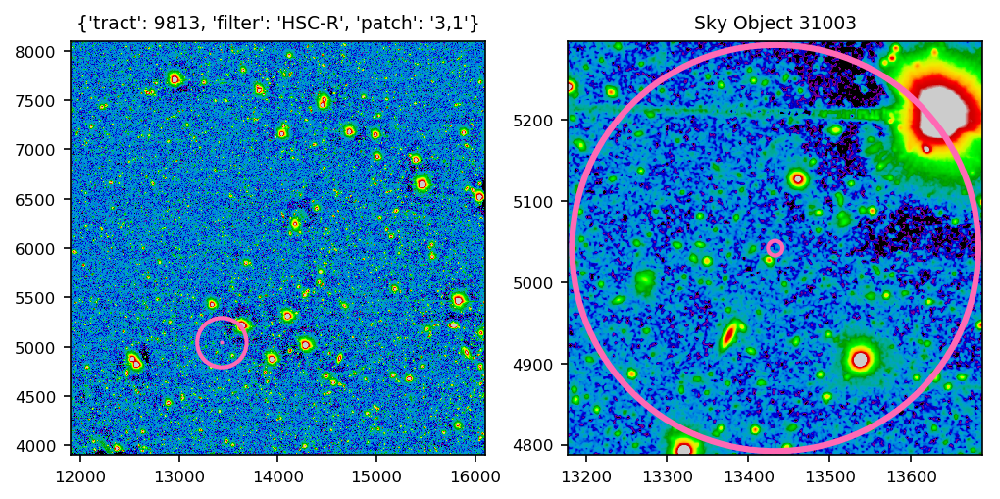

In [79]:
%matplotlib inline
oid = 31003
xlo = 12.3
xhi = 19.5
cid = int(np.where(objid2 == oid)[0])
# scatter plot
fig1 = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax1 = fig1.add_subplot(111)
ax1.fill_between([xlo,xhi], [1,1], [-1,-1], color='grey', alpha=0.5, label="$\pm1\mathregular{\epsilon_{sky}}$")
ax1.scatter(r250mag2, r9fluxperpixel2/skyerr, alpha=0.5, s=0.5, label="sky objects")
plt.axhline(y=0, c='k')
ax1.set_xlim(xlo,xhi)
ax1.set_ylim(-11,7)
plt.xlabel('regional brightness: 250 pix circ. aper. (mag)')
plt.ylabel('local sky offset: 9 pix circ. aper. ($\mathregular{\epsilon_{sky}}$)')
plt.title('Tract ' + str(dataid2['tract']) + ' (' + str(dataid2['filter']) + ') - Sky Object Flux Offset')
plt.plot(xrunmed, yrunmed/skyerr, c='r', label='median')
plt.plot(xrunmed, yrunsiglo/skyerr, c='firebrick', ls='--')
plt.plot(xrunmed, yrunsighi/skyerr, c='firebrick', ls='--')
handles, labels = ax1.get_legend_handles_labels()
handles = [handles[1], handles[2], handles[0]]
labels = [labels[1], labels[2], labels[0]]
ax1.legend(handles, labels, loc='upper left', fontsize=9)
ax1.scatter(r250mag2[cid], r9fluxperpixel2[cid]/skyerr)
ax1.annotate(str(oid), (r250mag2[cid], r9fluxperpixel2[cid]/skyerr), clip_on=True, fontsize=9, va='top')
plt.show()
# statistics
print('STATISTICS: OBJECT', oid)
print('local sky:', 
      'ADU:', np.round(r9flux2[cid],1), 
      ', ADU/pixel:', np.round(r9fluxperpixel2[cid],3), 
      ', εₛ:', np.round(r9fluxperpixel2[cid]/skyerr,1)
     )
print('regional:', 
      'ADU:', np.round(r250flux2[cid],1), 
      ', ADU/pixel:', np.round(r250fluxperpixel2[cid],3),
      ', mag:', np.round(r250mag2[cid],1)
     )
# butler get image
calexp2 = butler2.get('deepCoadd_calexp', dataId=dataids2[cid])
extent = (calexp2.image.getBBox().getBeginX(), calexp2.image.getBBox().getEndX(), 
          calexp2.image.getBBox().getBeginY(), calexp2.image.getBBox().getEndY())
# full image
fig2 = plt.figure(figsize=(8,4), dpi=150, facecolor='w', edgecolor='k')
ax2 = fig2.add_subplot(121)
ax2.tick_params(axis='both', which='major', labelsize=8)
img2, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img2, extent=extent, cmap="nipy_spectral")
medcircles2 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=2)
smallcircles2 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink')
plt.gcf().gca().add_artist(medcircles2)
plt.gcf().gca().add_artist(smallcircles2)
plt.title(str(dataids2[cid]), fontsize=9)
# zoom image
ax3 = fig2.add_subplot(122)
ax3.tick_params(axis='both', which='major', labelsize=8)
img3, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img3, extent=extent, cmap="nipy_spectral")
medcircles3 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=3)
smallcircles3 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink', linewidth=2)
plt.gcf().gca().add_artist(medcircles3)
plt.gcf().gca().add_artist(smallcircles3)
zoom = 255
plt.xlim(x2[cid]-zoom,x2[cid]+zoom)
plt.ylim(y2[cid]-zoom,y2[cid]+zoom)
plt.title('Sky Object '+ str(oid), fontsize=9)
plt.show()

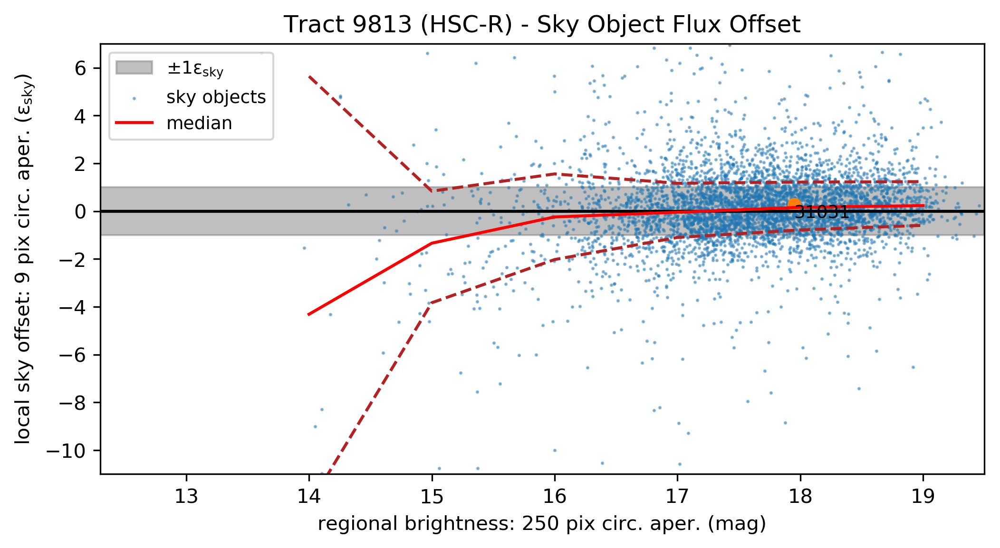

STATISTICS: OBJECT 31031
local sky: ADU: 0.2 , ADU/pixel: 0.001 , εₛ: 0.3
regional: ADU: 4167.4 , ADU/pixel: 0.021 , mag: 18.0


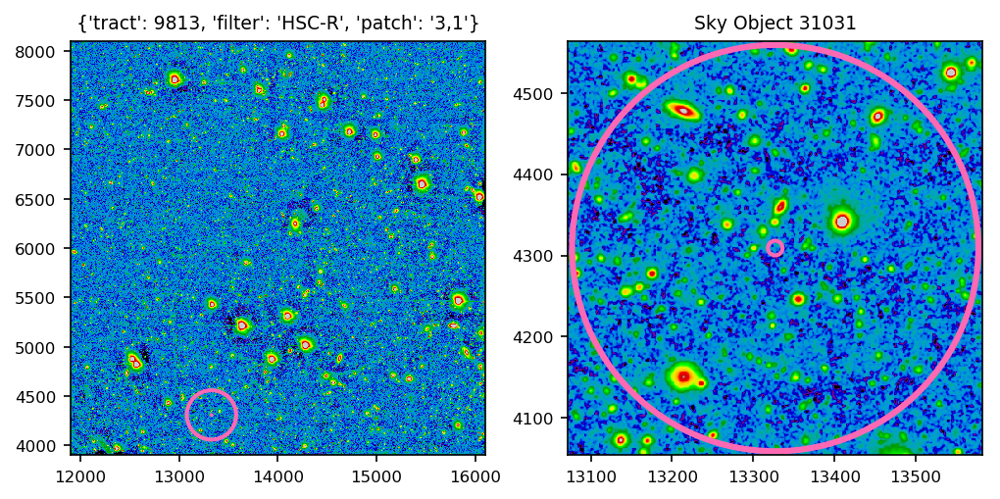

In [80]:
%matplotlib inline
oid = 31031
xlo = 12.3
xhi = 19.5
cid = int(np.where(objid2 == oid)[0])
# scatter plot
fig1 = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax1 = fig1.add_subplot(111)
ax1.fill_between([xlo,xhi], [1,1], [-1,-1], color='grey', alpha=0.5, label="$\pm1\mathregular{\epsilon_{sky}}$")
ax1.scatter(r250mag2, r9fluxperpixel2/skyerr, alpha=0.5, s=0.5, label="sky objects")
plt.axhline(y=0, c='k')
ax1.set_xlim(xlo,xhi)
ax1.set_ylim(-11,7)
plt.xlabel('regional brightness: 250 pix circ. aper. (mag)')
plt.ylabel('local sky offset: 9 pix circ. aper. ($\mathregular{\epsilon_{sky}}$)')
plt.title('Tract ' + str(dataid2['tract']) + ' (' + str(dataid2['filter']) + ') - Sky Object Flux Offset')
plt.plot(xrunmed, yrunmed/skyerr, c='r', label='median')
plt.plot(xrunmed, yrunsiglo/skyerr, c='firebrick', ls='--')
plt.plot(xrunmed, yrunsighi/skyerr, c='firebrick', ls='--')
handles, labels = ax1.get_legend_handles_labels()
handles = [handles[1], handles[2], handles[0]]
labels = [labels[1], labels[2], labels[0]]
ax1.legend(handles, labels, loc='upper left', fontsize=9)
ax1.scatter(r250mag2[cid], r9fluxperpixel2[cid]/skyerr)
ax1.annotate(str(oid), (r250mag2[cid], r9fluxperpixel2[cid]/skyerr), clip_on=True, fontsize=9, va='top')
plt.show()
# statistics
print('STATISTICS: OBJECT', oid)
print('local sky:', 
      'ADU:', np.round(r9flux2[cid],1), 
      ', ADU/pixel:', np.round(r9fluxperpixel2[cid],3), 
      ', εₛ:', np.round(r9fluxperpixel2[cid]/skyerr,1)
     )
print('regional:', 
      'ADU:', np.round(r250flux2[cid],1), 
      ', ADU/pixel:', np.round(r250fluxperpixel2[cid],3),
      ', mag:', np.round(r250mag2[cid],1)
     )
# butler get image
calexp2 = butler2.get('deepCoadd_calexp', dataId=dataids2[cid])
extent = (calexp2.image.getBBox().getBeginX(), calexp2.image.getBBox().getEndX(), 
          calexp2.image.getBBox().getBeginY(), calexp2.image.getBBox().getEndY())
# full image
fig2 = plt.figure(figsize=(8,4), dpi=150, facecolor='w', edgecolor='k')
ax2 = fig2.add_subplot(121)
ax2.tick_params(axis='both', which='major', labelsize=8)
img2, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img2, extent=extent, cmap="nipy_spectral")
medcircles2 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=2)
smallcircles2 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink')
plt.gcf().gca().add_artist(medcircles2)
plt.gcf().gca().add_artist(smallcircles2)
plt.title(str(dataids2[cid]), fontsize=9)
# zoom image
ax3 = fig2.add_subplot(122)
ax3.tick_params(axis='both', which='major', labelsize=8)
img3, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img3, extent=extent, cmap="nipy_spectral")
medcircles3 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=3)
smallcircles3 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink', linewidth=2)
plt.gcf().gca().add_artist(medcircles3)
plt.gcf().gca().add_artist(smallcircles3)
zoom = 255
plt.xlim(x2[cid]-zoom,x2[cid]+zoom)
plt.ylim(y2[cid]-zoom,y2[cid]+zoom)
plt.title('Sky Object '+ str(oid), fontsize=9)
plt.show()

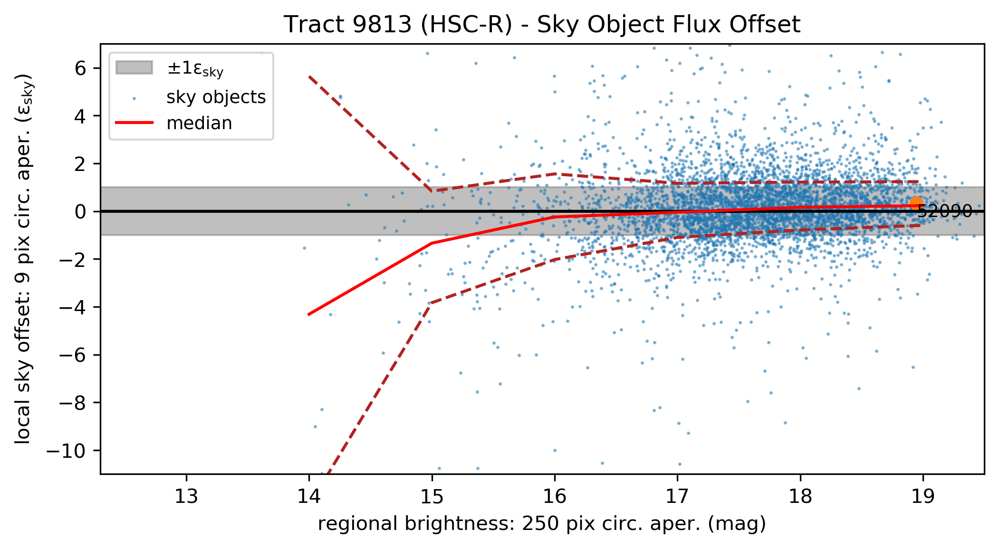

STATISTICS: OBJECT 52090
local sky: ADU: 0.2 , ADU/pixel: 0.001 , εₛ: 0.3
regional: ADU: 1665.2 , ADU/pixel: 0.008 , mag: 18.9


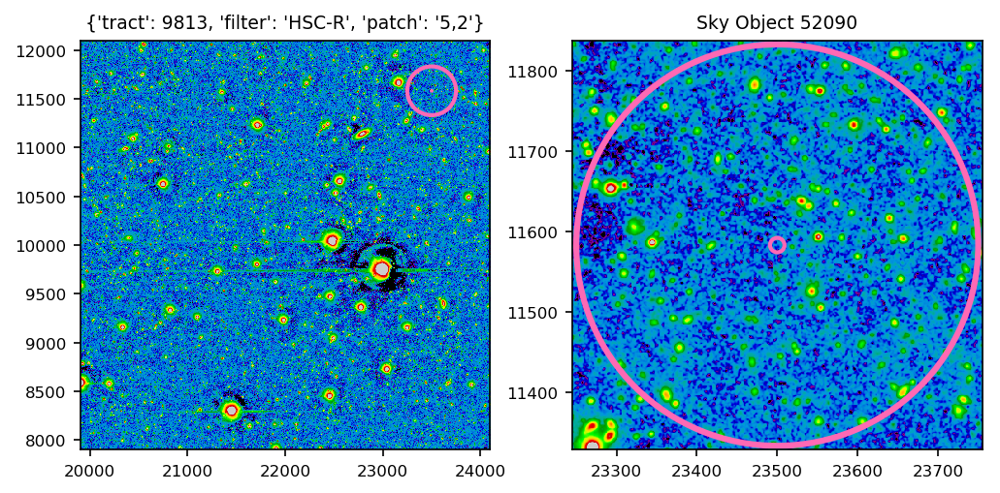

In [81]:
%matplotlib inline
oid = 52090
xlo = 12.3
xhi = 19.5
cid = int(np.where(objid2 == oid)[0])
# scatter plot
fig1 = plt.figure(figsize=(8,4), dpi=300, facecolor='w', edgecolor='k')
ax1 = fig1.add_subplot(111)
ax1.fill_between([xlo,xhi], [1,1], [-1,-1], color='grey', alpha=0.5, label="$\pm1\mathregular{\epsilon_{sky}}$")
ax1.scatter(r250mag2, r9fluxperpixel2/skyerr, alpha=0.5, s=0.5, label="sky objects")
plt.axhline(y=0, c='k')
ax1.set_xlim(xlo,xhi)
ax1.set_ylim(-11,7)
plt.xlabel('regional brightness: 250 pix circ. aper. (mag)')
plt.ylabel('local sky offset: 9 pix circ. aper. ($\mathregular{\epsilon_{sky}}$)')
plt.title('Tract ' + str(dataid2['tract']) + ' (' + str(dataid2['filter']) + ') - Sky Object Flux Offset')
plt.plot(xrunmed, yrunmed/skyerr, c='r', label='median')
plt.plot(xrunmed, yrunsiglo/skyerr, c='firebrick', ls='--')
plt.plot(xrunmed, yrunsighi/skyerr, c='firebrick', ls='--')
handles, labels = ax1.get_legend_handles_labels()
handles = [handles[1], handles[2], handles[0]]
labels = [labels[1], labels[2], labels[0]]
ax1.legend(handles, labels, loc='upper left', fontsize=9)
ax1.scatter(r250mag2[cid], r9fluxperpixel2[cid]/skyerr)
ax1.annotate(str(oid), (r250mag2[cid], r9fluxperpixel2[cid]/skyerr), clip_on=True, fontsize=9, va='top')
plt.show()
# statistics
print('STATISTICS: OBJECT', oid)
print('local sky:', 
      'ADU:', np.round(r9flux2[cid],1), 
      ', ADU/pixel:', np.round(r9fluxperpixel2[cid],3), 
      ', εₛ:', np.round(r9fluxperpixel2[cid]/skyerr,1)
     )
print('regional:', 
      'ADU:', np.round(r250flux2[cid],1), 
      ', ADU/pixel:', np.round(r250fluxperpixel2[cid],3),
      ', mag:', np.round(r250mag2[cid],1)
     )
# butler get image
calexp2 = butler2.get('deepCoadd_calexp', dataId=dataids2[cid])
extent = (calexp2.image.getBBox().getBeginX(), calexp2.image.getBBox().getEndX(), 
          calexp2.image.getBBox().getBeginY(), calexp2.image.getBBox().getEndY())
# full image
fig2 = plt.figure(figsize=(8,4), dpi=150, facecolor='w', edgecolor='k')
ax2 = fig2.add_subplot(121)
ax2.tick_params(axis='both', which='major', labelsize=8)
img2, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img2, extent=extent, cmap="nipy_spectral")
medcircles2 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=2)
smallcircles2 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink')
plt.gcf().gca().add_artist(medcircles2)
plt.gcf().gca().add_artist(smallcircles2)
plt.title(str(dataids2[cid]), fontsize=9)
# zoom image
ax3 = fig2.add_subplot(122)
ax3.tick_params(axis='both', which='major', labelsize=8)
img3, lo, hi = imprep(np.flip(calexp2.image.array, 0), fwhm=3, lo=-0.01, hi=2)
plt.imshow(img3, extent=extent, cmap="nipy_spectral")
medcircles3 = plt.Circle((x2[cid], y2[cid]), radius=250, fc='none', ec='hotpink', linewidth=3)
smallcircles3 = plt.Circle((x2[cid], y2[cid]), radius=9, fc='none', ec='hotpink', linewidth=2)
plt.gcf().gca().add_artist(medcircles3)
plt.gcf().gca().add_artist(smallcircles3)
zoom = 255
plt.xlim(x2[cid]-zoom,x2[cid]+zoom)
plt.ylim(y2[cid]-zoom,y2[cid]+zoom)
plt.title('Sky Object '+ str(oid), fontsize=9)
plt.show()

# Conclusions

Definite potential with this method, but sky objects are not designed for analysis of this issue. Several issues with sky objects and circular aperture photometry were discovered, and future updates should aim to correct for these. They include:

* improve random sky object positional placement
* report number of used pixels within each circular aperture
* calculate circular aperture statistics for sources close to field edges